# Build a Conditional GAN

### Goals
In this notebook, you're going to make a conditional GAN in order to generate hand-written images of digits, conditioned on the digit to be generated (the class vector). This will let you choose what digit you want to generate.

You'll then do some exploration of the generated images to visualize what the noise and class vectors mean.  

### Learning Objectives
1.   Learn the technical difference between a conditional and unconditional GAN.
2.   Understand the distinction between the class and noise vector in a conditional GAN.



## Getting Started

For this assignment, you will be using the MNIST dataset again, but there's nothing stopping you from applying this generator code to produce images of animals conditioned on the species or pictures of faces conditioned on facial characteristics.

Note that this assignment requires no changes to the architectures of the generator or discriminator, only changes to the data passed to both. The generator will no longer take `z_dim` as an argument, but  `input_dim` instead, since you need to pass in both the noise and class vectors. In addition to good variable naming, this also means that you can use the generator and discriminator code you have previously written with different parameters.

You will begin by importing the necessary libraries and building the generator and discriminator.

#### Packages and Visualization

In [1]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for our testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28), nrow=5, show=True):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=nrow)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    if show:
        plt.show()

#### Generator and Noise

In [2]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        input_dim: the dimension of the input vector, a scalar
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, input_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.input_dim = input_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(input_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor, 
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, input_dim)
        '''
        x = noise.view(len(noise), self.input_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, input_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, input_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
        n_samples: the number of samples to generate, a scalar
        input_dim: the dimension of the input vector, a scalar
        device: the device type
    '''
    return torch.randn(n_samples, input_dim, device=device)

#### Discriminator

In [3]:
class Discriminator(nn.Module):
    '''
    Discriminator Class
    Values:
      im_chan: the number of channels in the images, fitted for the dataset used, a scalar
            (MNIST is black-and-white, so 1 channel is your default)
      hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            self.make_disc_block(im_chan, hidden_dim),
            self.make_disc_block(hidden_dim, hidden_dim * 2),
            self.make_disc_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_disc_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a discriminator block of the DCGAN; 
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the discriminator: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        disc_pred = self.disc(image)
        return disc_pred.view(len(disc_pred), -1)

## Class Input

In conditional GANs, the input vector for the generator will also need to include the class information. The class is represented using a one-hot encoded vector where its length is the number of classes and each index represents a class. The vector is all 0's and a 1 on the chosen class. Given the labels of multiple images (e.g. from a batch) and number of classes, please create one-hot vectors for each label. There is a class within the PyTorch functional library that can help you.

<details>

<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">get_one_hot_labels</font></code></b>
</font>
</summary>

1.   This code can be done in one line.
2.   The documentation for [F.one_hot](https://pytorch.org/docs/stable/nn.functional.html#torch.nn.functional.one_hot) may be helpful.

</details>


In [4]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_one_hot_labels

import torch.nn.functional as F
def get_one_hot_labels(labels, n_classes):
    '''
    Function for creating one-hot vectors for the labels, returns a tensor of shape (?, num_classes).
    Parameters:
        labels: tensor of labels from the dataloader, size (?)
        n_classes: the total number of classes in the dataset, an integer scalar
    '''
    #### START CODE HERE ####
    return F.one_hot(labels, n_classes)
    #### END CODE HERE ####

In [5]:
assert (
    get_one_hot_labels(
        labels=torch.Tensor([[0, 2, 1]]).long(),
        n_classes=3
    ).tolist() == 
    [[
      [1, 0, 0], 
      [0, 0, 1], 
      [0, 1, 0]
    ]]
)
print("Success!")

Success!


Next, you need to be able to concatenate the one-hot class vector to the noise vector before giving it to the generator. You will also need to do this when adding the class channels to the discriminator.

To do this, you will need to write a function that combines two vectors. Remember that you need to ensure that the vectors are the same type: floats. Again, you can look to the PyTorch library for help.
<details>
<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">combine_vectors</font></code></b>
</font>
</summary>

1.   This code can also be written in one line.
2.   The documentation for [torch.cat](https://pytorch.org/docs/master/generated/torch.cat.html) may be helpful.
3.   Specifically, you might want to look at what the `dim` argument of `torch.cat` does.

</details>


In [6]:
# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: combine_vectors
def combine_vectors(x, y):
    '''
    Function for combining two vectors with shapes (n_samples, ?) and (n_samples, ?).
    Parameters:
      x: (n_samples, ?) the first vector. 
        In this assignment, this will be the noise vector of shape (n_samples, z_dim), 
        but you shouldn't need to know the second dimension's size.
      y: (n_samples, ?) the second vector.
        Once again, in this assignment this will be the one-hot class vector 
        with the shape (n_samples, n_classes), but you shouldn't assume this in your code.
    '''
    # Note: Make sure this function outputs a float no matter what inputs it receives
    #### START CODE HERE ####
    combined = torch.cat((x.float(), y.float()), 1)
    #### END CODE HERE ####
    return combined

In [7]:
combined = combine_vectors(torch.tensor([[1, 2], [3, 4]]), torch.tensor([[5, 6], [7, 8]]));
# Check exact order of elements
assert torch.all(combined == torch.tensor([[1, 2, 5, 6], [3, 4, 7, 8]]))
# Tests that items are of float type
assert (type(combined[0][0].item()) == float)
# Check shapes
combined = combine_vectors(torch.randn(1, 4, 5), torch.randn(1, 8, 5));
assert tuple(combined.shape) == (1, 12, 5)
assert tuple(combine_vectors(torch.randn(1, 10, 12).long(), torch.randn(1, 20, 12).long()).shape) == (1, 30, 12)
print("Success!")

Success!


## Training
Now you can start to put it all together!
First, you will define some new parameters:

*   mnist_shape: the number of pixels in each MNIST image, which has dimensions 28 x 28 and one channel (because it's black-and-white) so 1 x 28 x 28
*   n_classes: the number of classes in MNIST (10, since there are the digits from 0 to 9)

In [8]:
mnist_shape = (1, 28, 28)
n_classes = 10

And you also include the same parameters from previous assignments:

  *   criterion: the loss function
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   device: the device type


In [9]:
criterion = nn.BCEWithLogitsLoss()
n_epochs = 200
z_dim = 64
display_step = 500
batch_size = 128
lr = 0.0002
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=False, transform=transform),
    batch_size=batch_size,
    shuffle=True)

Then, you can initialize your generator, discriminator, and optimizers. To do this, you will need to update the input dimensions for both models. For the generator, you will need to calculate the size of the input vector; recall that for conditional GANs, the generator's input is the noise vector concatenated with the class vector. For the discriminator, you need to add a channel for every class.

In [10]:
# UNQ_C3 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_input_dimensions
def get_input_dimensions(z_dim, mnist_shape, n_classes):
    '''
    Function for getting the size of the conditional input dimensions 
    from z_dim, the image shape, and number of classes.
    Parameters:
        z_dim: the dimension of the noise vector, a scalar
        mnist_shape: the shape of each MNIST image as (C, W, H), which is (1, 28, 28)
        n_classes: the total number of classes in the dataset, an integer scalar
                (10 for MNIST)
    Returns: 
        generator_input_dim: the input dimensionality of the conditional generator, 
                          which takes the noise and class vectors
        discriminator_im_chan: the number of input channels to the discriminator
                            (e.g. C x 28 x 28 for MNIST)
    '''
    #### START CODE HERE ####
    generator_input_dim = z_dim + n_classes
    discriminator_im_chan = mnist_shape[0] + n_classes
    #### END CODE HERE ####
    return generator_input_dim, discriminator_im_chan

In [11]:
def test_input_dims():
    gen_dim, disc_dim = get_input_dimensions(23, (12, 23, 52), 9)
    assert gen_dim == 32
    assert disc_dim == 21
test_input_dims()
print("Success!")

Success!


In [12]:
generator_input_dim, discriminator_im_chan = get_input_dimensions(z_dim, mnist_shape, n_classes)

gen = Generator(input_dim=generator_input_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
disc = Discriminator(im_chan=discriminator_im_chan).to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
disc = disc.apply(weights_init)

Now to train, you would like both your generator and your discriminator to know what class of image should be generated. There are a few locations where you will need to implement code.

For example, if you're generating a picture of the number "1", you would need to:
  
1.   Tell that to the generator, so that it knows it should be generating a "1"
2.   Tell that to the discriminator, so that it knows it should be looking at a "1". If the discriminator is told it should be looking at a 1 but sees something that's clearly an 8, it can guess that it's probably fake

There are no explicit unit tests here -- if this block of code runs and you don't change any of the other variables, then you've done it correctly!

Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!



Step 500: Generator loss: 2.1942238072156908, discriminator loss: 0.2423584614917636


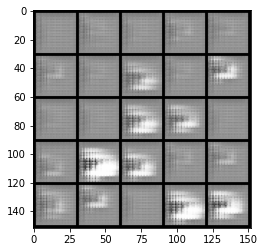

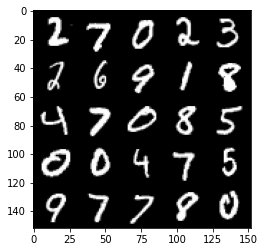

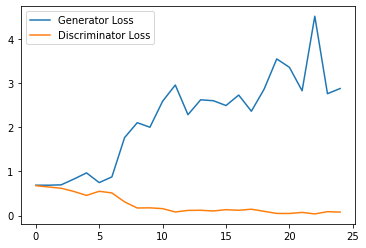

Step 1000: Generator loss: 4.341089639186859, discriminator loss: 0.027935905506834387


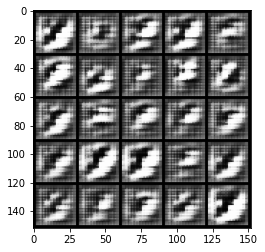

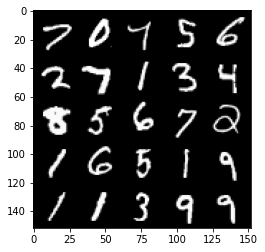

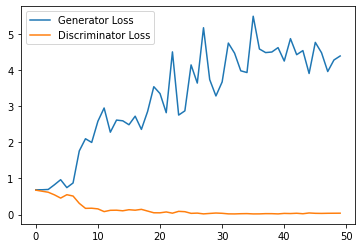

Step 1500: Generator loss: 4.027867083072662, discriminator loss: 0.06849671823903919


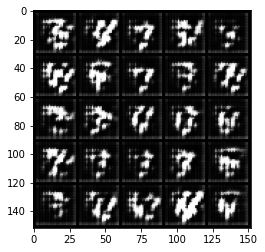

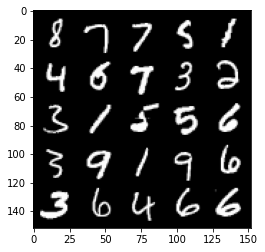

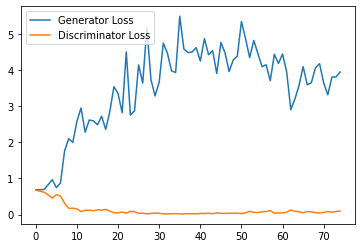

Step 2000: Generator loss: 3.167991832971573, discriminator loss: 0.16073483404517175


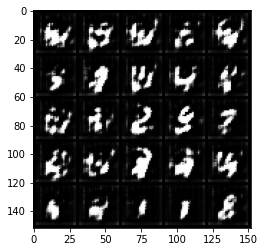

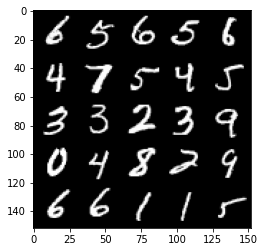

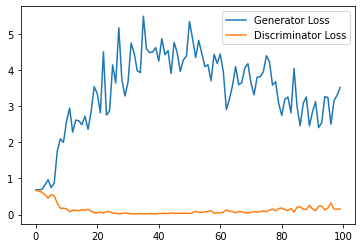

Step 2500: Generator loss: 2.582383064031601, discriminator loss: 0.24135060200095176


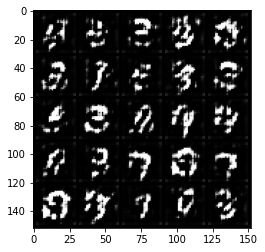

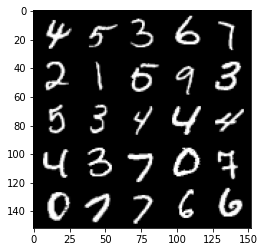

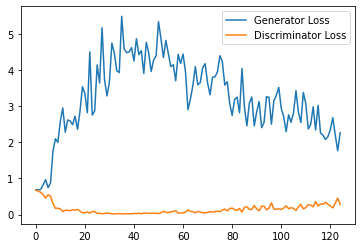

Step 3000: Generator loss: 2.195950136899948, discriminator loss: 0.30399850809574125


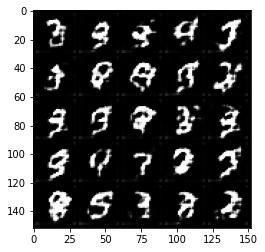

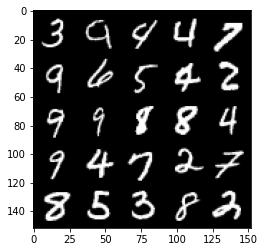

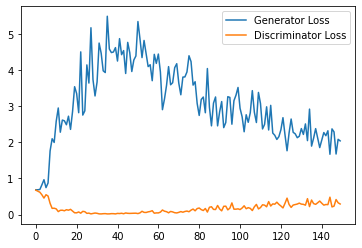

Step 3500: Generator loss: 2.081594938278198, discriminator loss: 0.3381425368487835


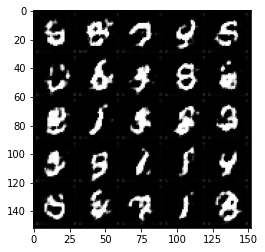

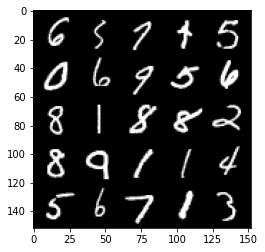

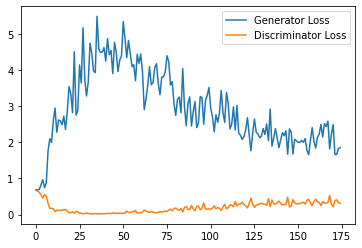

Step 4000: Generator loss: 1.968121946334839, discriminator loss: 0.35653335389494895


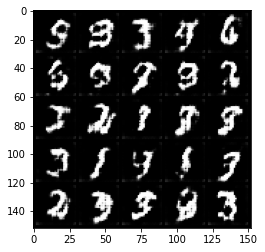

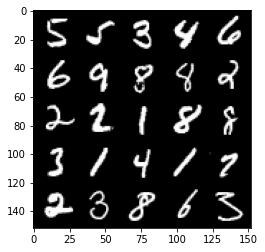

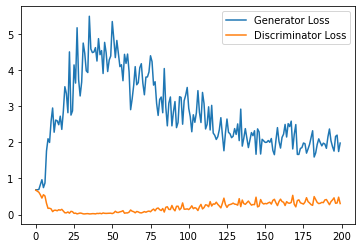

Step 4500: Generator loss: 1.8696450746059419, discriminator loss: 0.3703447020947933


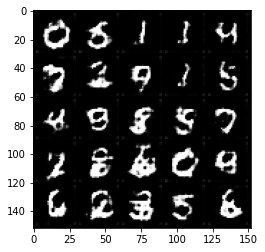

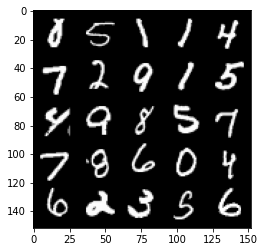

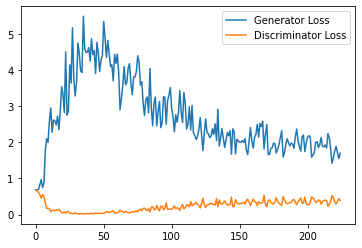

Step 5000: Generator loss: 1.728448462486267, discriminator loss: 0.3893484813868999


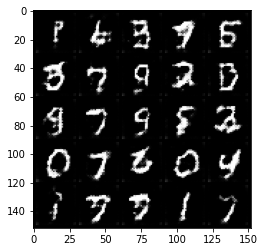

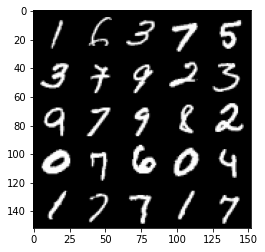

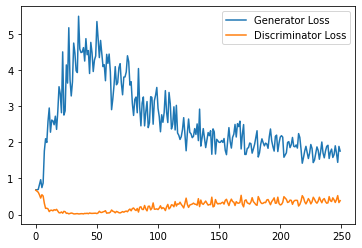

Step 5500: Generator loss: 1.6942690868377686, discriminator loss: 0.4448559429347515


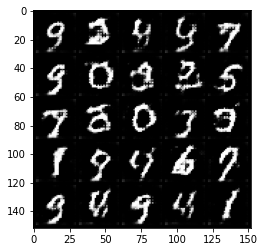

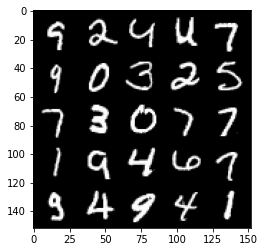

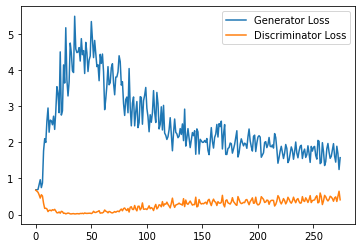

Step 6000: Generator loss: 1.7681029983758927, discriminator loss: 0.42870094811916354


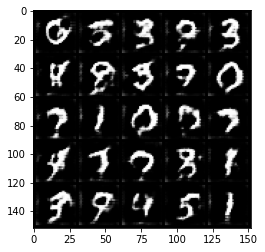

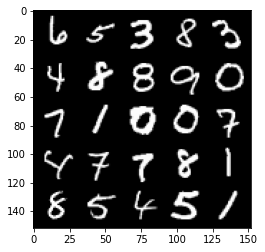

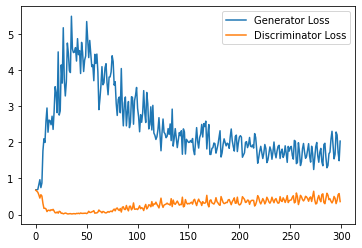

Step 6500: Generator loss: 1.6102392196655273, discriminator loss: 0.45015939193964005


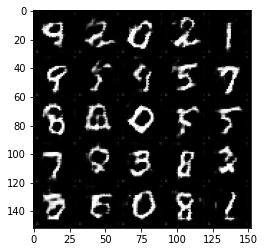

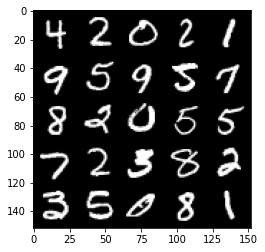

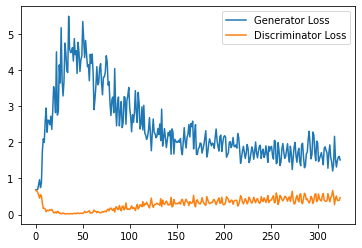

Step 7000: Generator loss: 1.51401886510849, discriminator loss: 0.4782151725292206


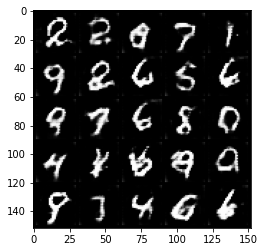

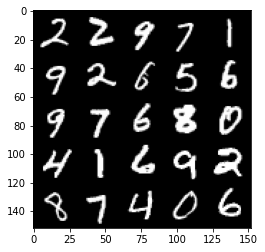

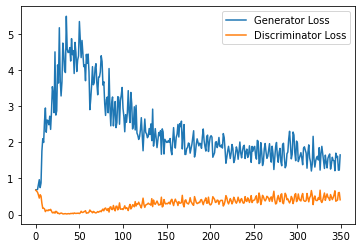

Step 7500: Generator loss: 1.503945601940155, discriminator loss: 0.48515826112031935


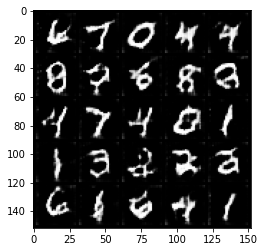

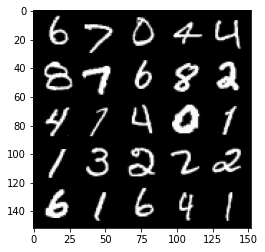

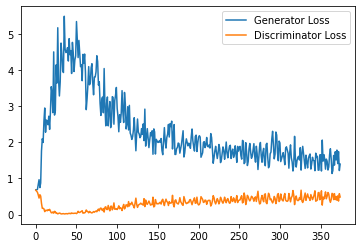

Step 8000: Generator loss: 1.3140519849061967, discriminator loss: 0.5104937045574188


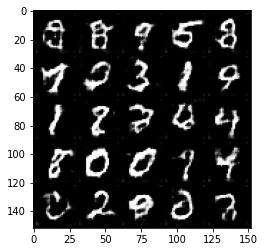

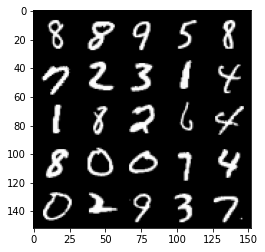

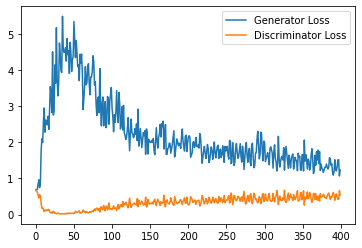

Step 8500: Generator loss: 1.3077349164485932, discriminator loss: 0.5156429644227027


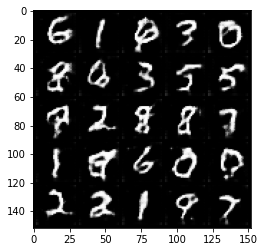

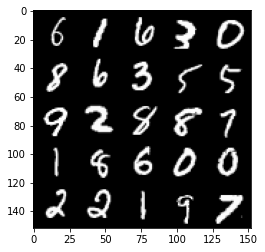

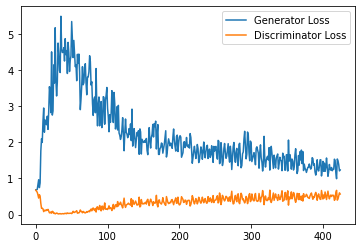

Step 9000: Generator loss: 1.2829507772922515, discriminator loss: 0.5201946697235107


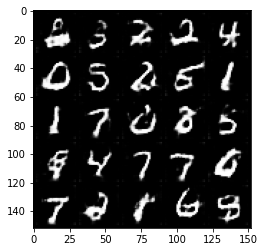

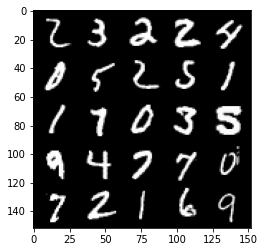

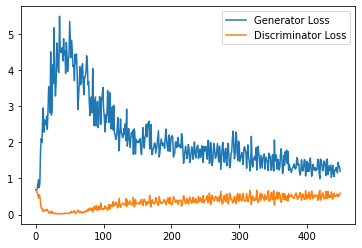

Step 9500: Generator loss: 1.3319404500722885, discriminator loss: 0.5170587208867073


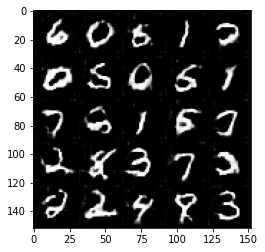

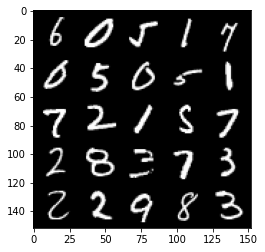

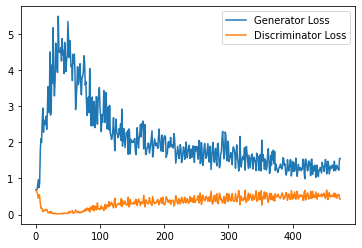

Step 10000: Generator loss: 1.2717517024278642, discriminator loss: 0.536818697988987


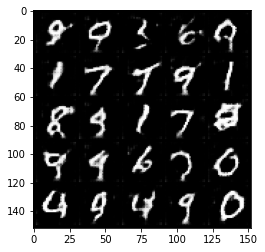

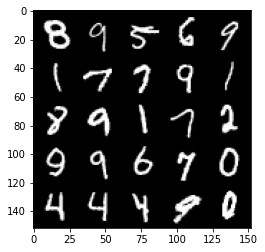

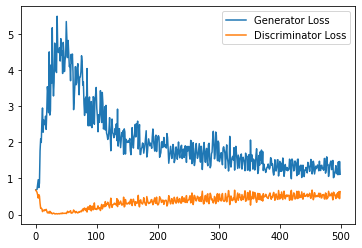

Step 10500: Generator loss: 1.2376758488416673, discriminator loss: 0.5341002194285392


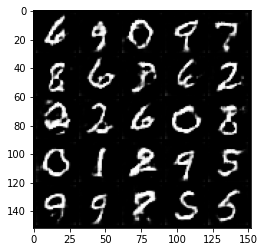

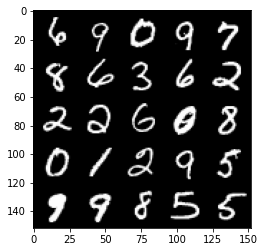

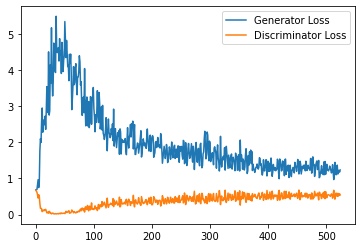

Step 11000: Generator loss: 1.240403876543045, discriminator loss: 0.5385957841277123


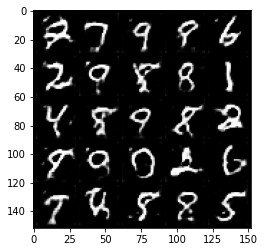

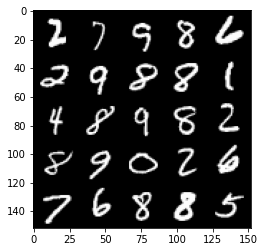

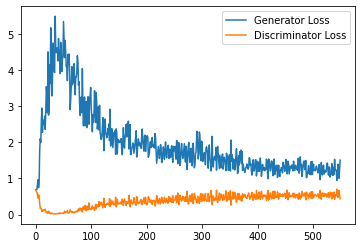

Step 11500: Generator loss: 1.228664004445076, discriminator loss: 0.5351930568814278


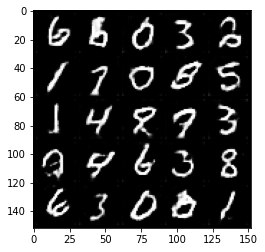

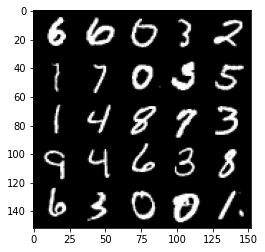

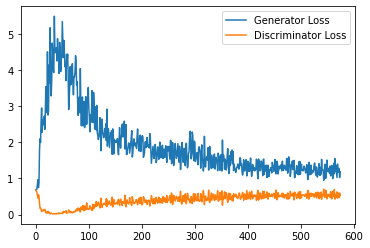

Step 12000: Generator loss: 1.1770709887742996, discriminator loss: 0.5416581128239631


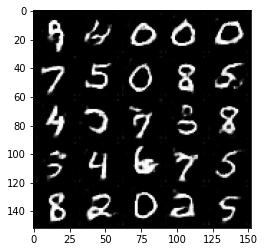

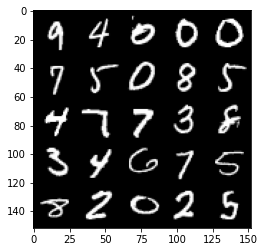

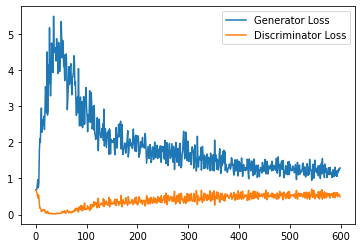

Step 12500: Generator loss: 1.1758536803722381, discriminator loss: 0.5489517072439194


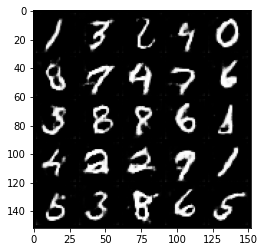

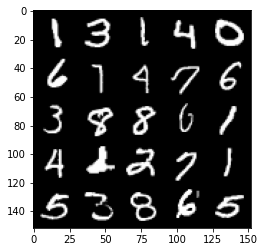

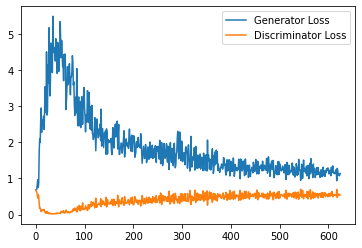

Step 13000: Generator loss: 1.1468796143531799, discriminator loss: 0.5498717993497848


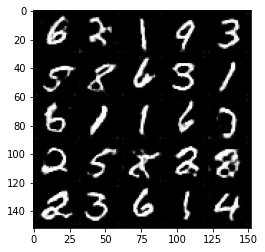

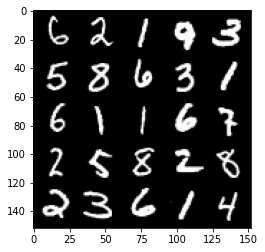

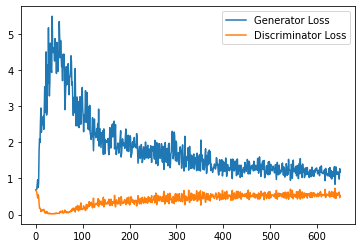

Step 13500: Generator loss: 1.12529896569252, discriminator loss: 0.5586446053981781


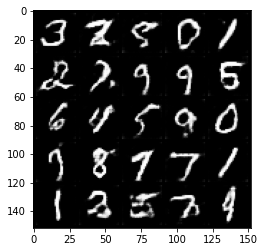

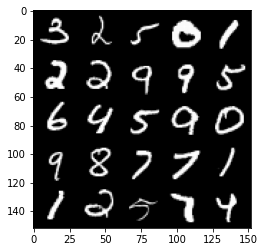

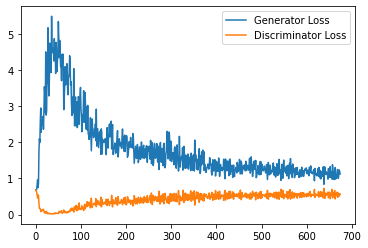

Step 14000: Generator loss: 1.1392323442697525, discriminator loss: 0.5534557182788848


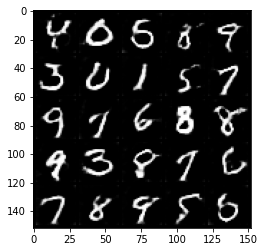

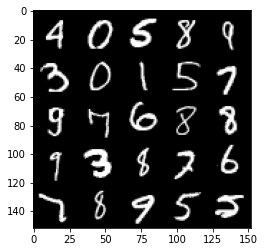

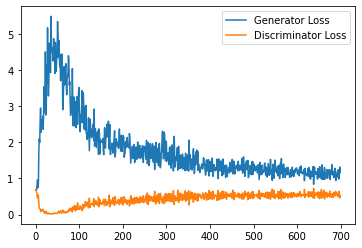

Step 14500: Generator loss: 1.1213096784353256, discriminator loss: 0.5639190257787704


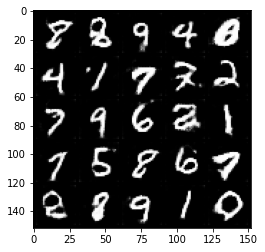

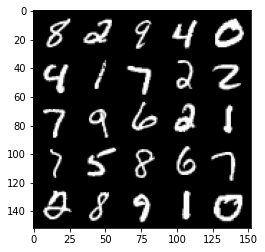

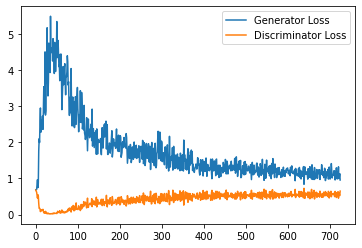

Step 15000: Generator loss: 1.1165855076313018, discriminator loss: 0.5601329473257065


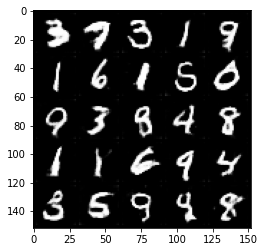

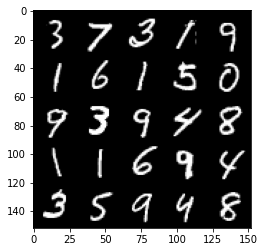

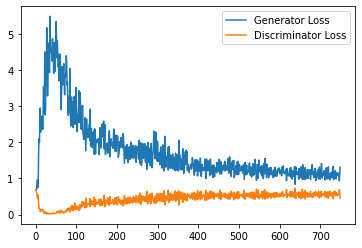

Step 15500: Generator loss: 1.0902549533843995, discriminator loss: 0.5675944209694862


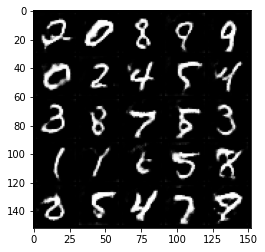

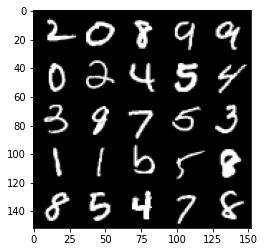

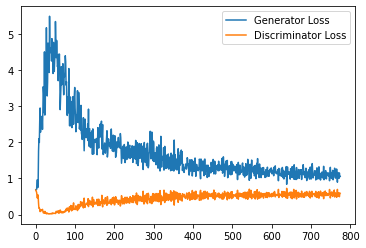

Step 16000: Generator loss: 1.0978439552783965, discriminator loss: 0.5709361110329628


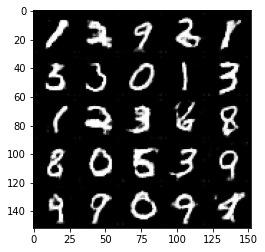

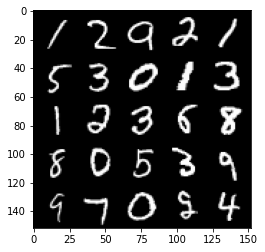

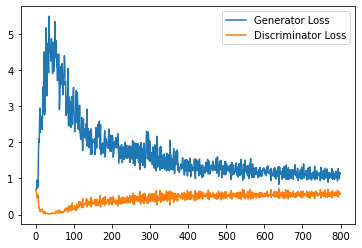

Step 16500: Generator loss: 1.1088656895160676, discriminator loss: 0.5647303782701493


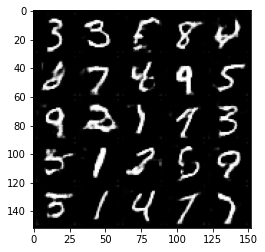

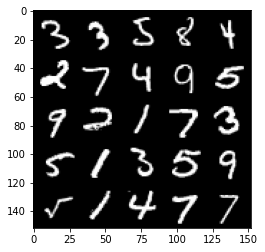

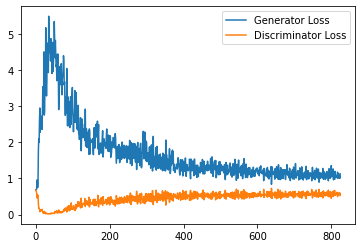

Step 17000: Generator loss: 1.0607234259843827, discriminator loss: 0.5724808202385903


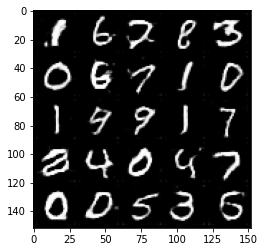

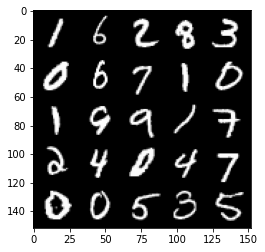

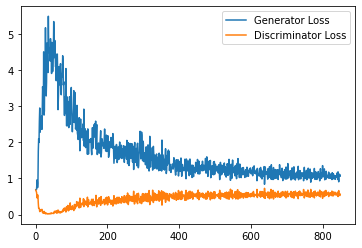

Step 17500: Generator loss: 1.0711060961484908, discriminator loss: 0.5739579240679741


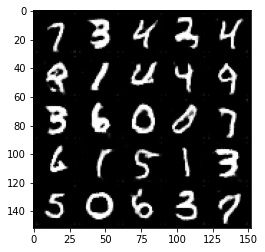

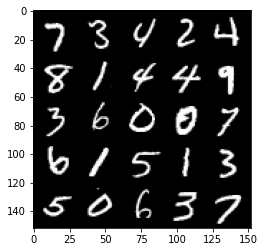

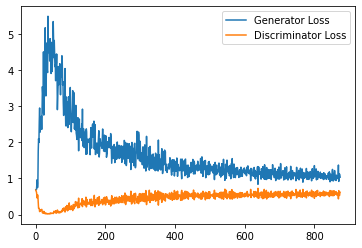

Step 18000: Generator loss: 1.049403261065483, discriminator loss: 0.5747617433667183


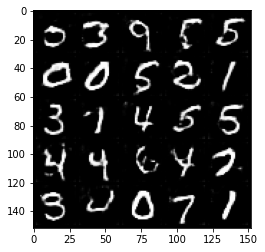

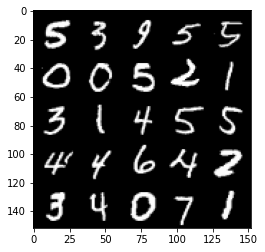

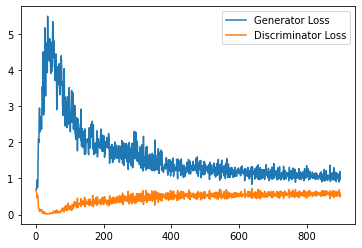

Step 18500: Generator loss: 1.0545106744766235, discriminator loss: 0.5791536776423454


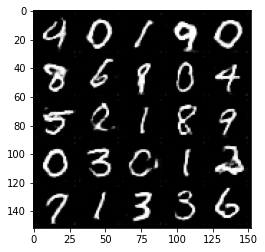

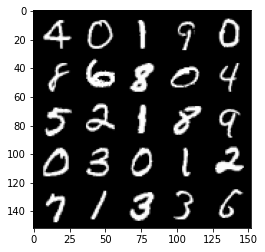

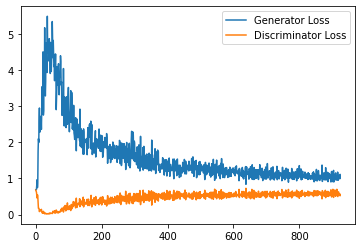

Step 19000: Generator loss: 1.0577001365423202, discriminator loss: 0.5797758479714393


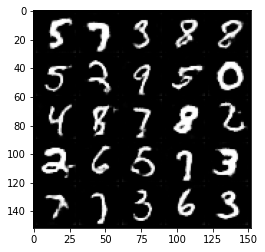

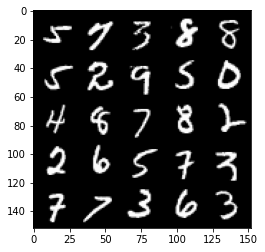

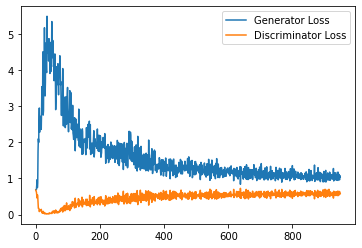

Step 19500: Generator loss: 1.0543605555295945, discriminator loss: 0.5700587017536163


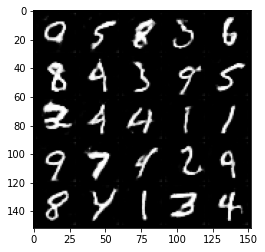

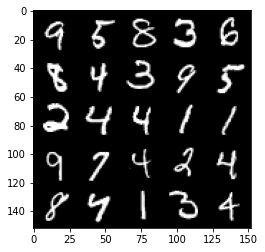

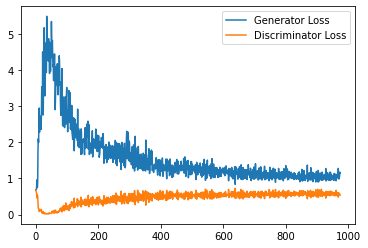

Step 20000: Generator loss: 1.0495473754405975, discriminator loss: 0.5818244212269783


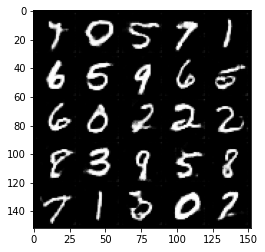

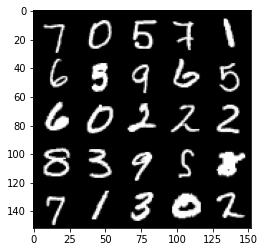

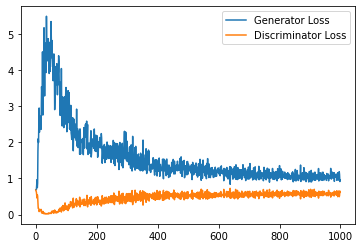

Step 20500: Generator loss: 1.0506647325754166, discriminator loss: 0.5766248151659965


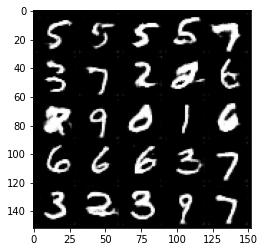

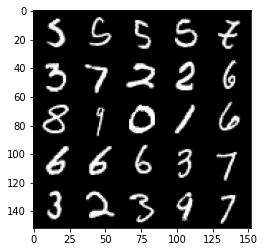

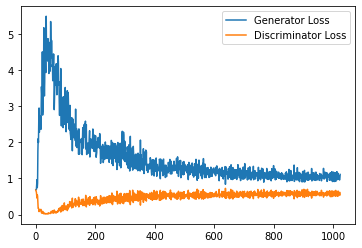

Step 21000: Generator loss: 1.0244837856292726, discriminator loss: 0.5749668318033219


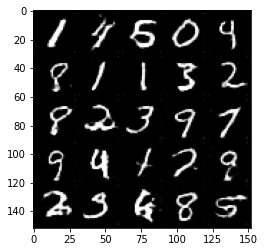

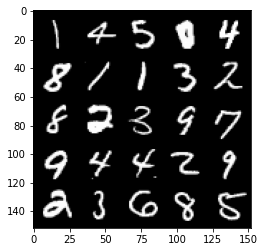

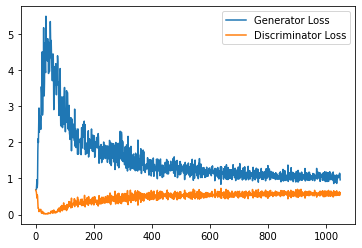

Step 21500: Generator loss: 1.0209560663700104, discriminator loss: 0.5757661290168762


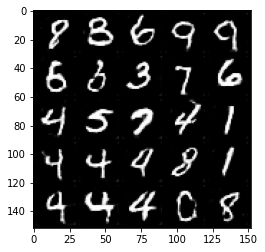

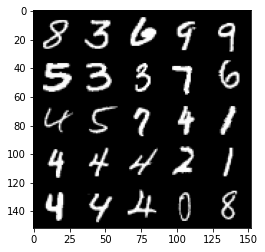

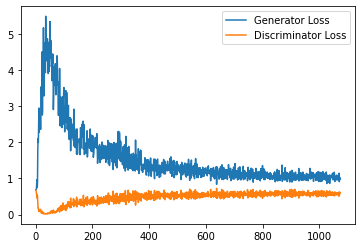

Step 22000: Generator loss: 1.0620466779470443, discriminator loss: 0.5693782552480697


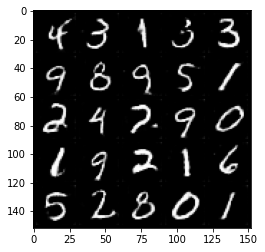

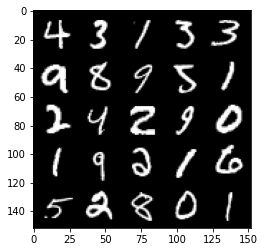

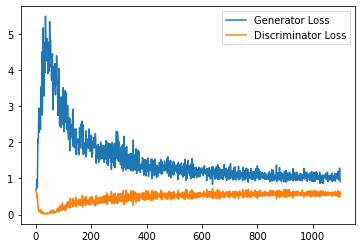

Step 22500: Generator loss: 1.0415205072164535, discriminator loss: 0.5741356104016304


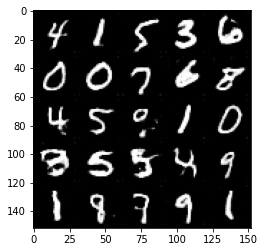

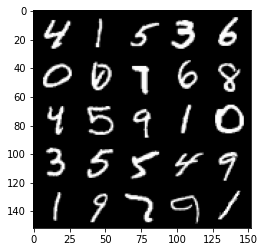

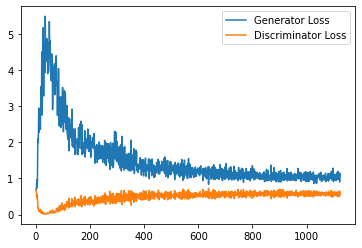

Step 23000: Generator loss: 1.0390483207702637, discriminator loss: 0.5790631086230278


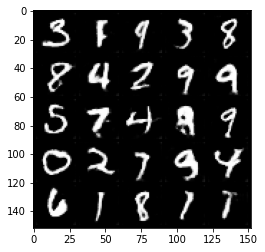

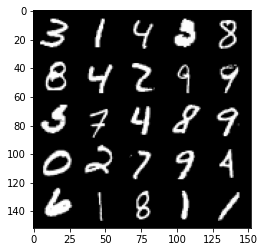

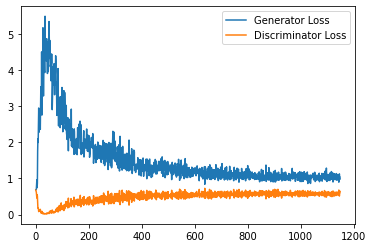

Step 23500: Generator loss: 1.064456549167633, discriminator loss: 0.574216621696949


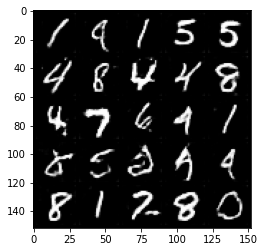

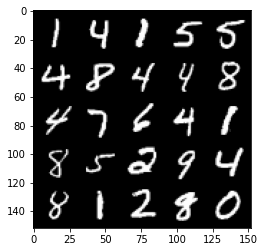

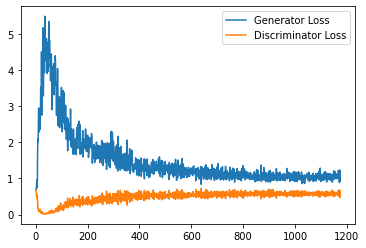

Step 24000: Generator loss: 1.0290887709856034, discriminator loss: 0.5771462919712067


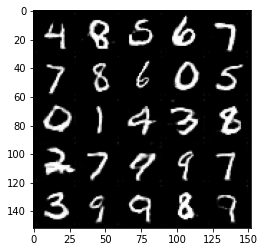

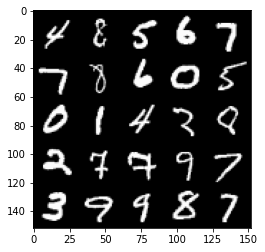

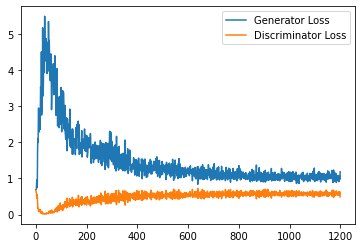

Step 24500: Generator loss: 1.0306721929311753, discriminator loss: 0.5820473245978356


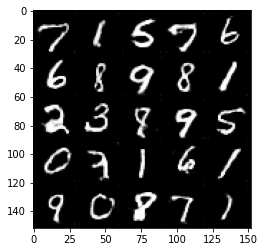

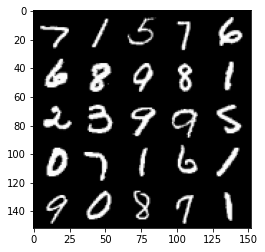

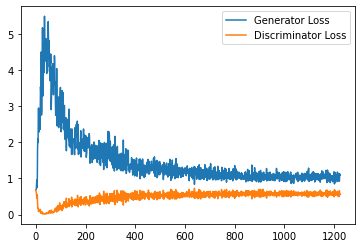

Step 25000: Generator loss: 1.0218388330936432, discriminator loss: 0.5800980748534202


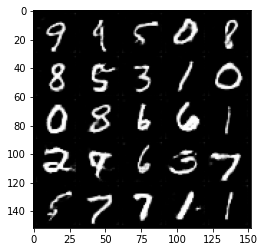

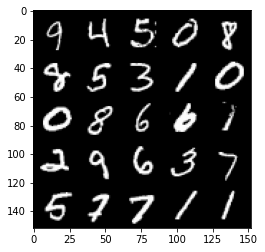

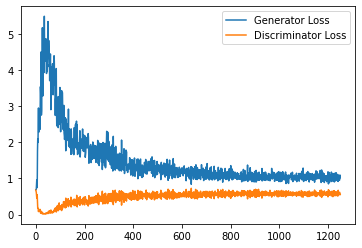

Step 25500: Generator loss: 1.0229059463739396, discriminator loss: 0.5798390390872955


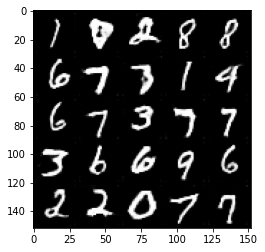

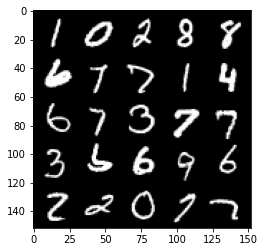

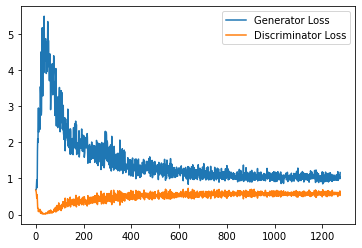

Step 26000: Generator loss: 1.0166785407066345, discriminator loss: 0.5818272054195404


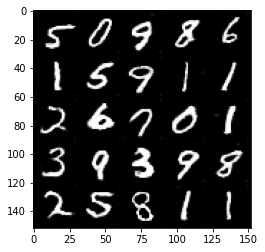

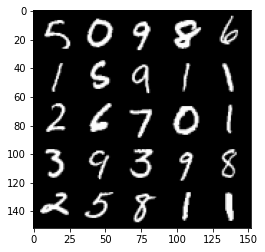

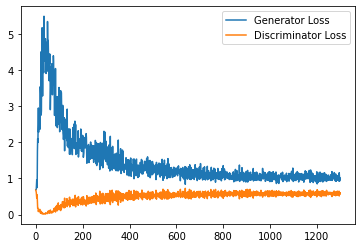

Step 26500: Generator loss: 1.0230463807582855, discriminator loss: 0.5797626155018807


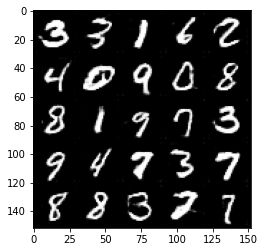

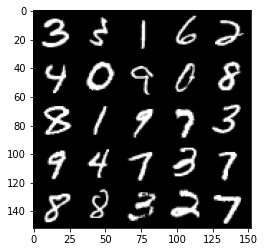

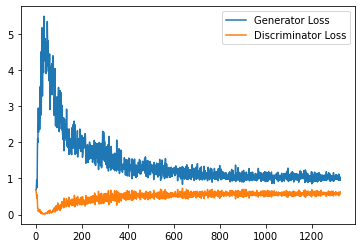

Step 27000: Generator loss: 1.0337742102146148, discriminator loss: 0.5790416585803032


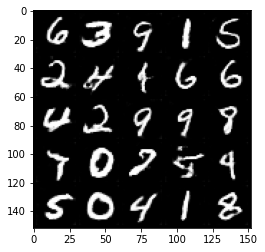

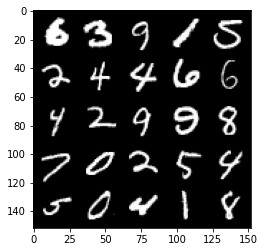

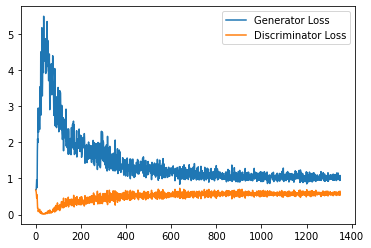

Step 27500: Generator loss: 1.0173895939588546, discriminator loss: 0.5818780900835991


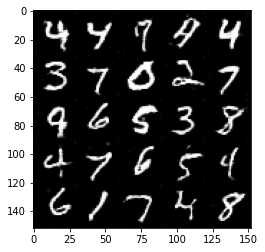

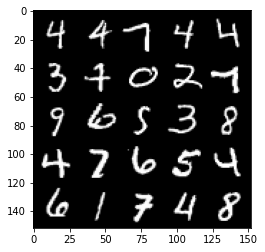

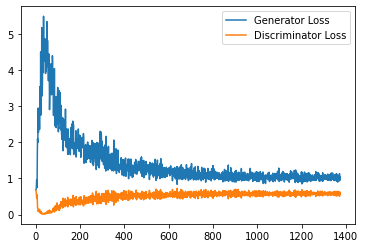

Step 28000: Generator loss: 1.0492784068584442, discriminator loss: 0.5781916112303734


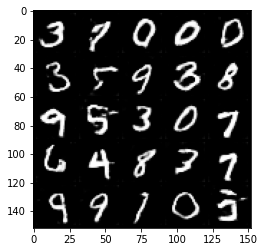

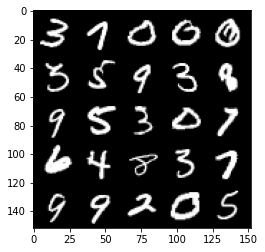

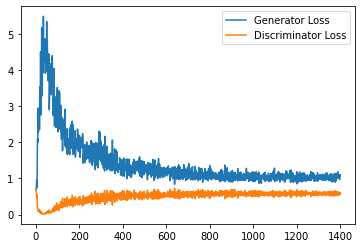

Step 28500: Generator loss: 1.0213571240901946, discriminator loss: 0.5857466516494751


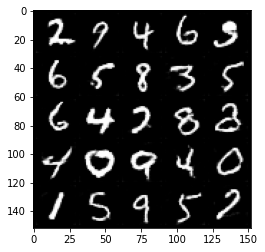

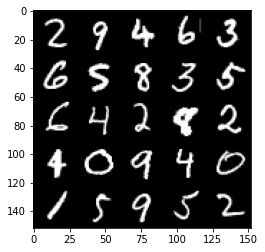

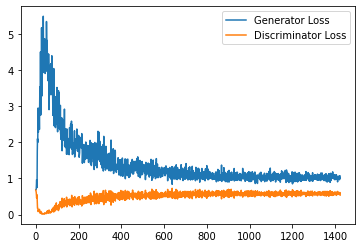

Step 29000: Generator loss: 1.0243425068855285, discriminator loss: 0.5841813368797302


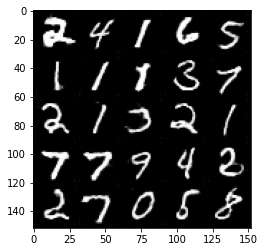

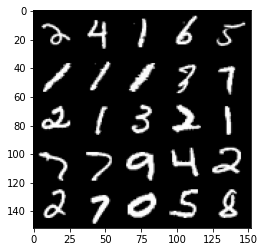

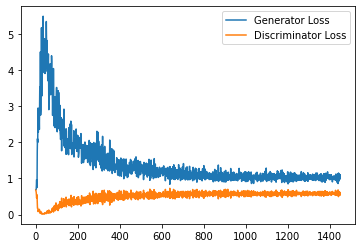

Step 29500: Generator loss: 1.001990206003189, discriminator loss: 0.5863309375047684


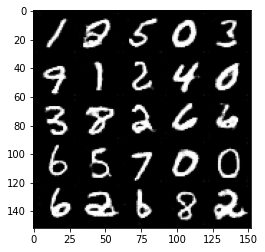

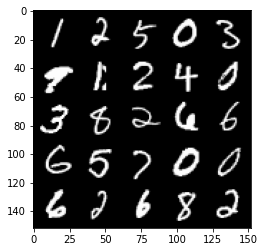

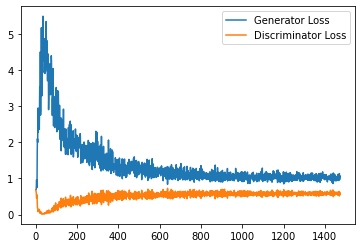

Step 30000: Generator loss: 1.033466355919838, discriminator loss: 0.5875102844238281


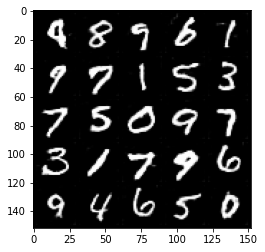

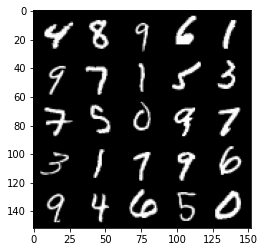

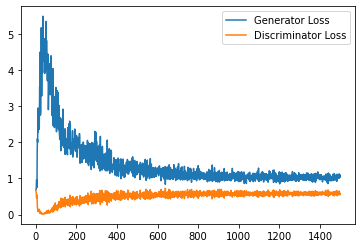

Step 30500: Generator loss: 1.011797107577324, discriminator loss: 0.5873843128681183


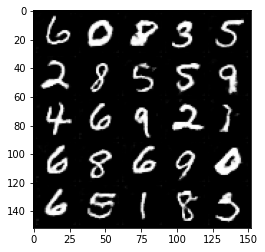

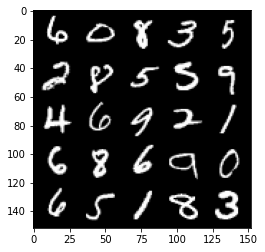

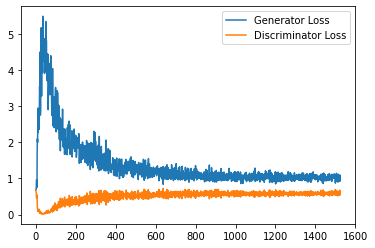

Step 31000: Generator loss: 1.0207223442792892, discriminator loss: 0.5903885962367058


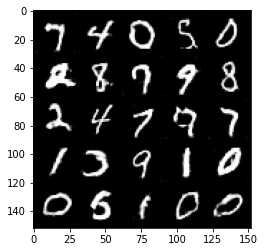

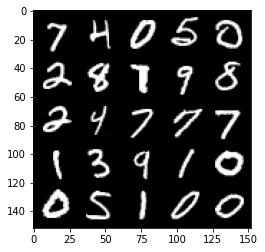

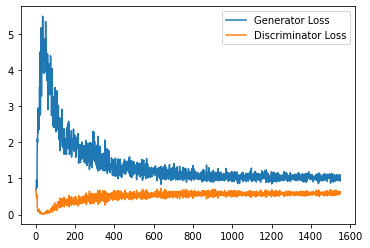

Step 31500: Generator loss: 1.0256806575059891, discriminator loss: 0.58939037245512


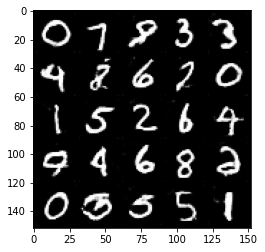

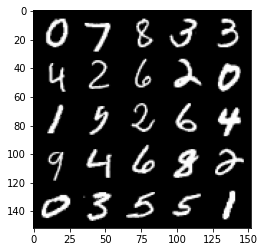

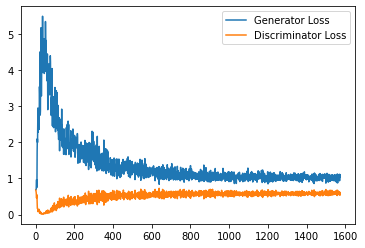

Step 32000: Generator loss: 1.0254754350185393, discriminator loss: 0.591298379600048


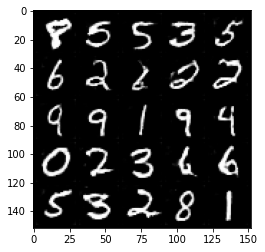

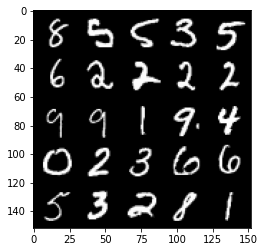

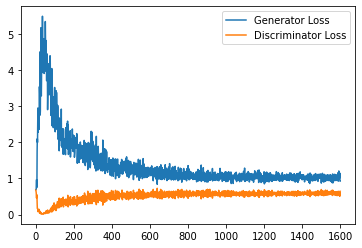

Step 32500: Generator loss: 1.0262085349559784, discriminator loss: 0.5912606711983681


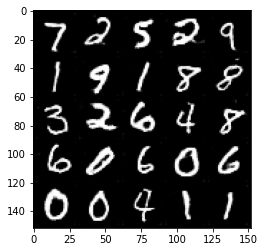

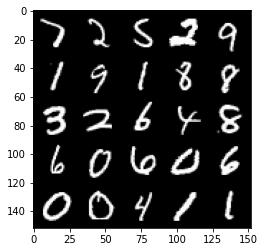

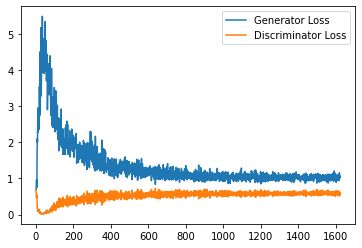

Step 33000: Generator loss: 1.0242603075504304, discriminator loss: 0.592348313510418


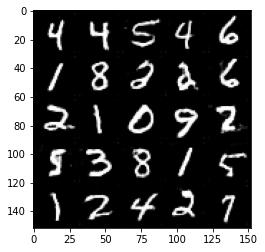

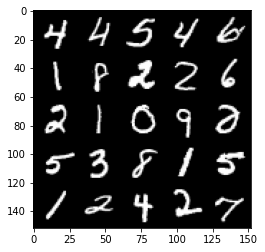

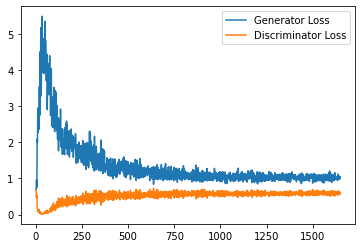

Step 33500: Generator loss: 1.0034555971622467, discriminator loss: 0.5963127022385597


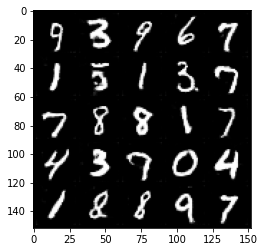

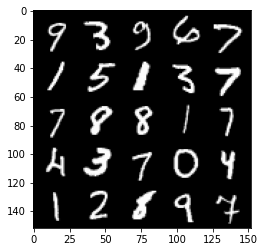

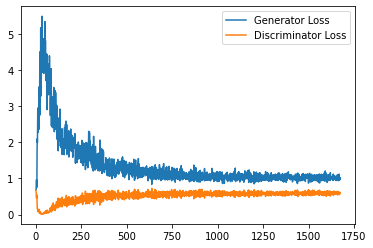

Step 34000: Generator loss: 1.0125560574531556, discriminator loss: 0.5936366691589355


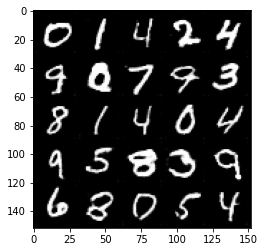

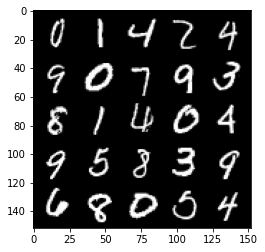

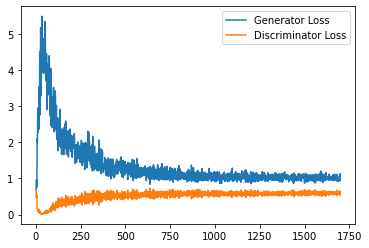

Step 34500: Generator loss: 1.0060694309473037, discriminator loss: 0.5942701244354248


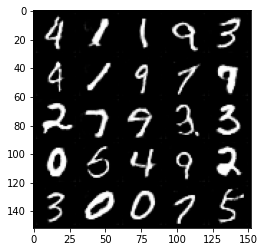

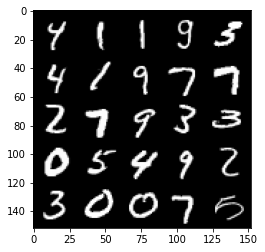

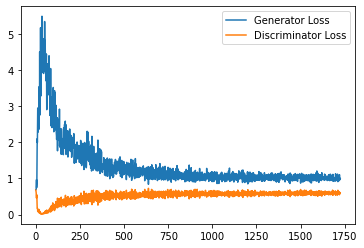

Step 35000: Generator loss: 0.9961860983371734, discriminator loss: 0.6011153187155723


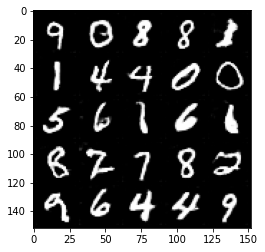

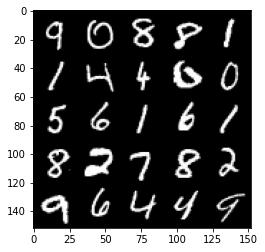

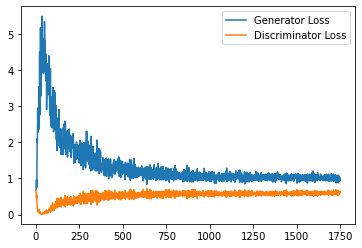

Step 35500: Generator loss: 1.0038585033416747, discriminator loss: 0.5933568286895752


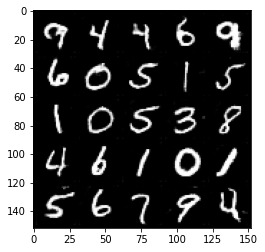

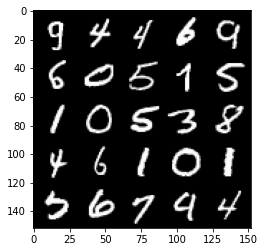

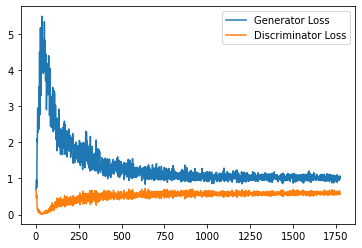

Step 36000: Generator loss: 0.9982762701511383, discriminator loss: 0.5983576397895813


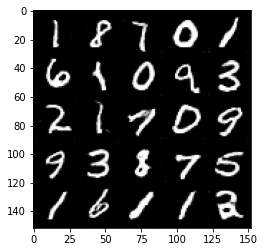

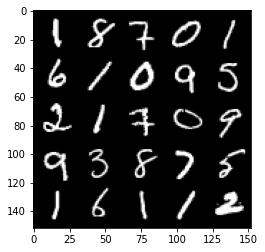

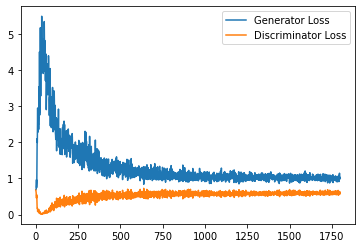

Step 36500: Generator loss: 1.0425089222192765, discriminator loss: 0.5985862327218056


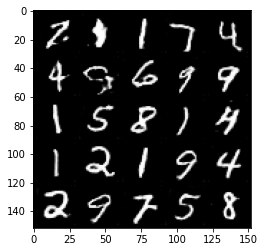

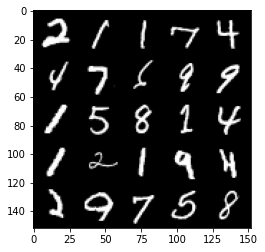

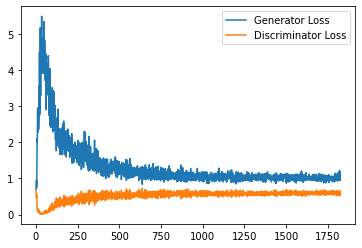

Step 37000: Generator loss: 1.0248833906650543, discriminator loss: 0.5985743217468261


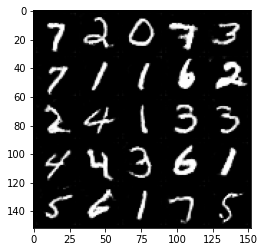

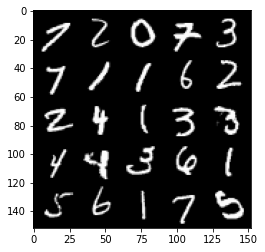

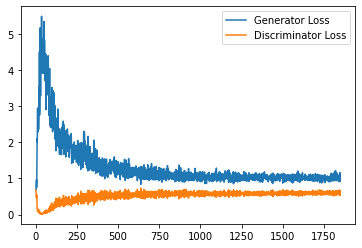

Step 37500: Generator loss: 0.9902349256277084, discriminator loss: 0.5911516775488853


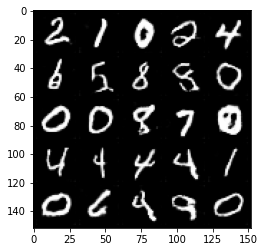

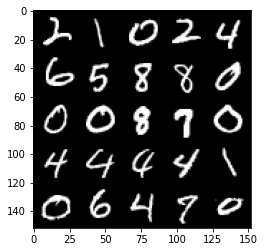

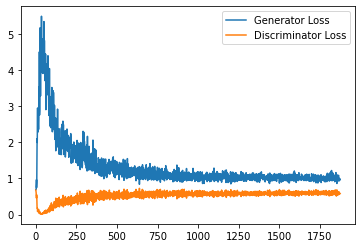

Step 38000: Generator loss: 1.0012807959318162, discriminator loss: 0.5956335436105729


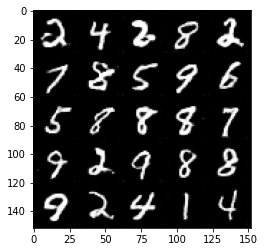

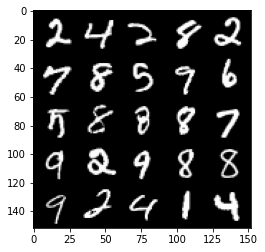

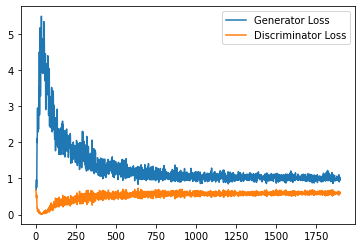

Step 38500: Generator loss: 1.0245024297237397, discriminator loss: 0.5988162340521812


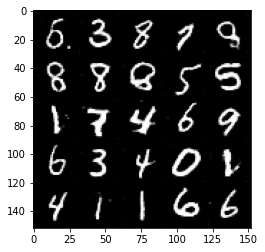

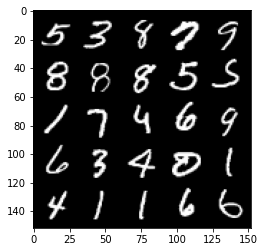

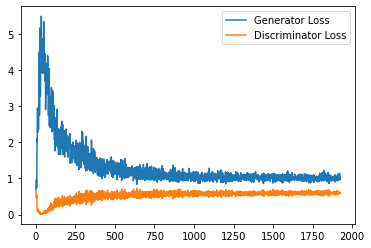

Step 39000: Generator loss: 1.001893643975258, discriminator loss: 0.6000748771429062


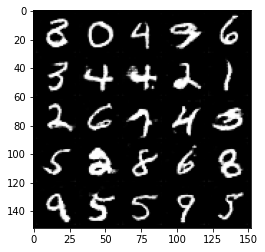

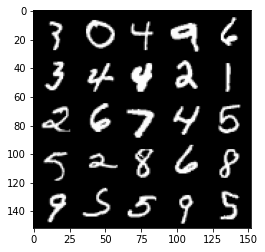

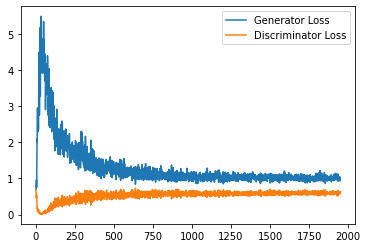

Step 39500: Generator loss: 1.009320278763771, discriminator loss: 0.5949762514829635


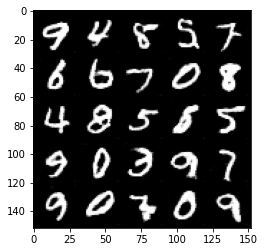

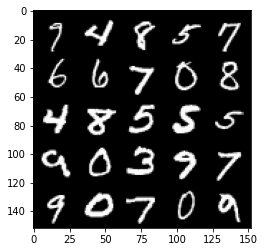

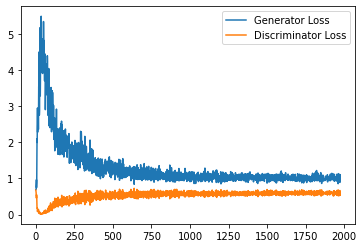

Step 40000: Generator loss: 1.0018813381195069, discriminator loss: 0.5962231015563011


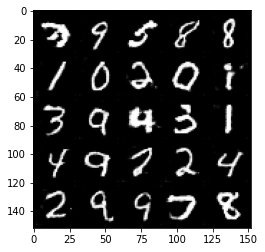

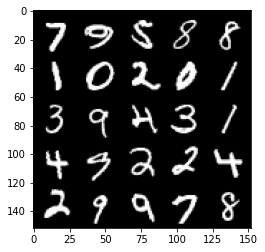

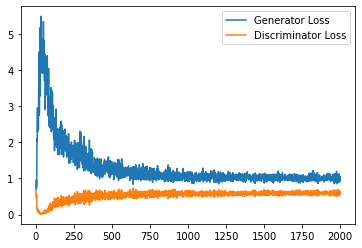

Step 40500: Generator loss: 1.0225416305065156, discriminator loss: 0.5971642642617225


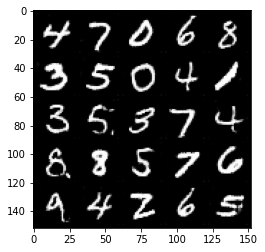

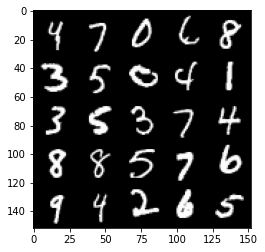

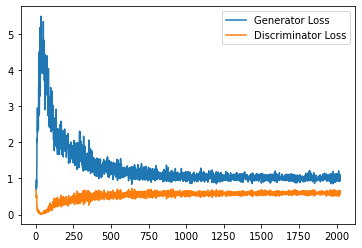

Step 41000: Generator loss: 1.0054671142101288, discriminator loss: 0.5919011447429657


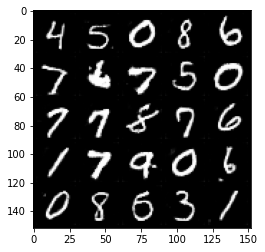

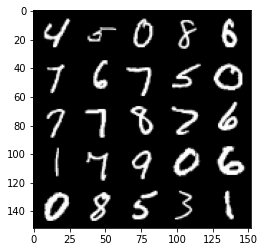

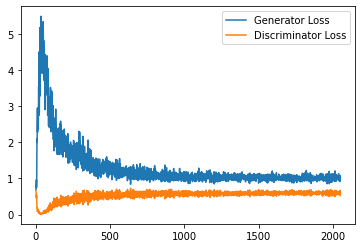

Step 41500: Generator loss: 1.0045280789136886, discriminator loss: 0.5955302063822746


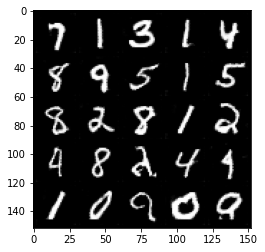

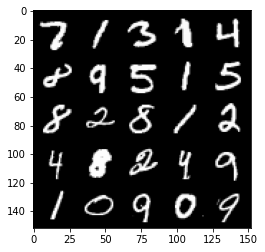

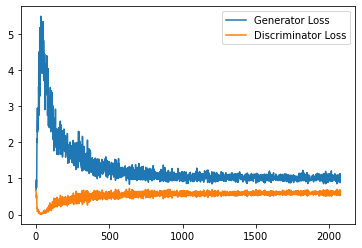

Step 42000: Generator loss: 1.0104703574180602, discriminator loss: 0.597284929215908


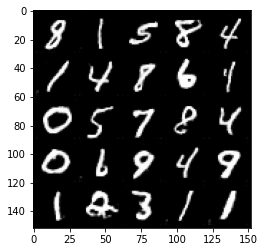

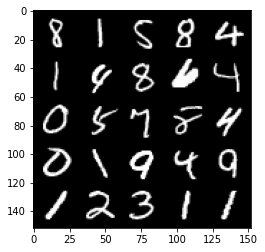

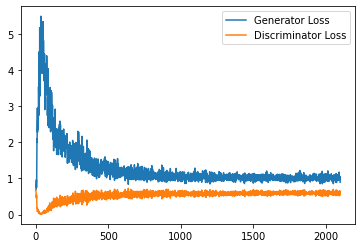

Step 42500: Generator loss: 1.0003828693628312, discriminator loss: 0.5953274191617965


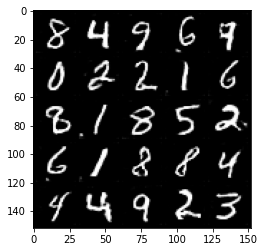

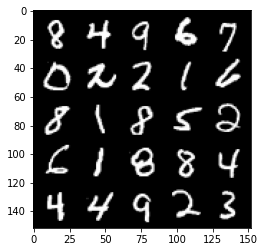

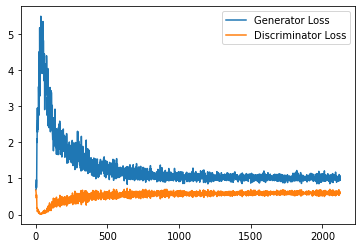

Step 43000: Generator loss: 0.9966831893920899, discriminator loss: 0.5957682148814202


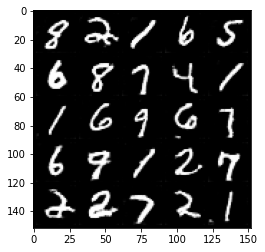

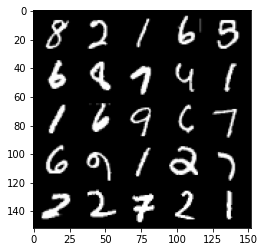

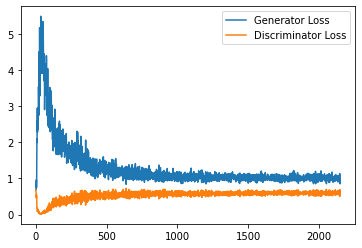

Step 43500: Generator loss: 1.0119636380672454, discriminator loss: 0.5925855713486672


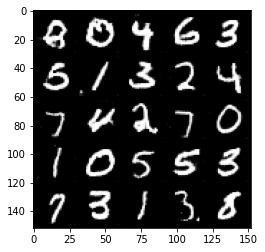

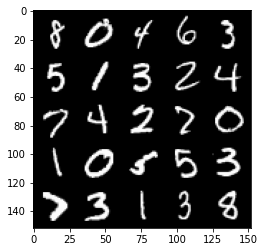

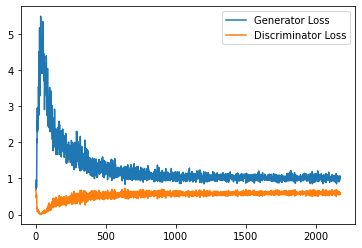

Step 44000: Generator loss: 1.025957591533661, discriminator loss: 0.5967696046233177


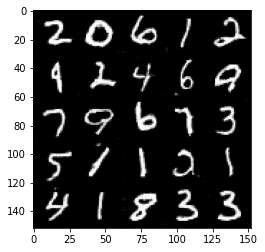

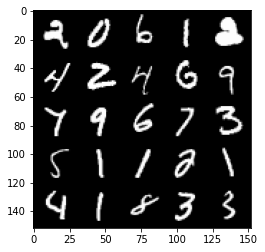

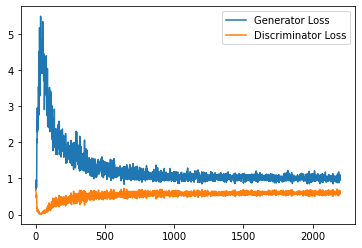

Step 44500: Generator loss: 1.00199762403965, discriminator loss: 0.5930948639512063


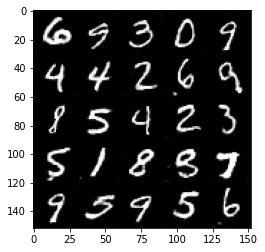

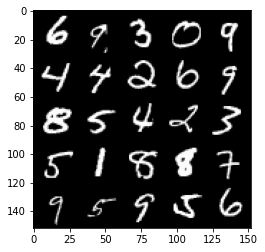

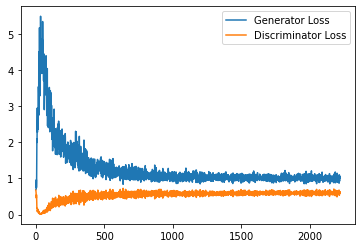

Step 45000: Generator loss: 1.005698147058487, discriminator loss: 0.5946321569681168


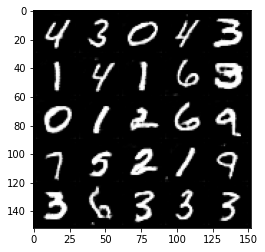

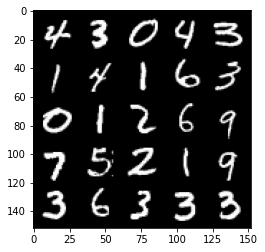

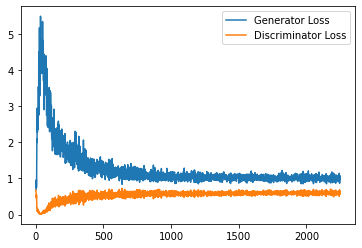

Step 45500: Generator loss: 1.0245012398958206, discriminator loss: 0.5918152093887329


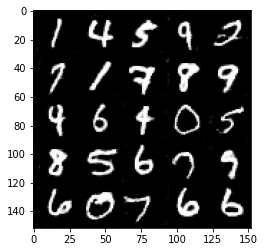

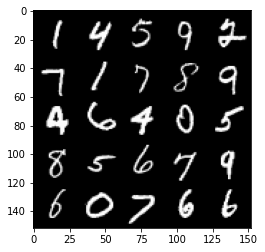

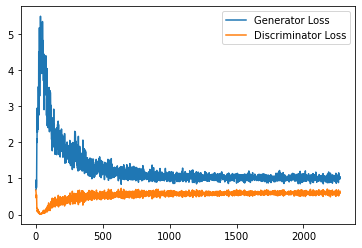

Step 46000: Generator loss: 1.0173114576339721, discriminator loss: 0.5948304344415665


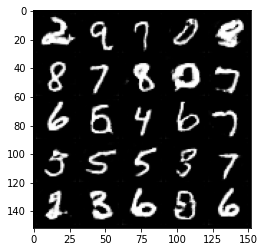

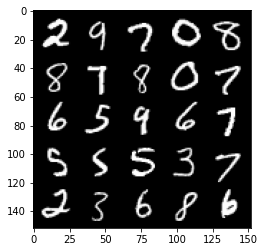

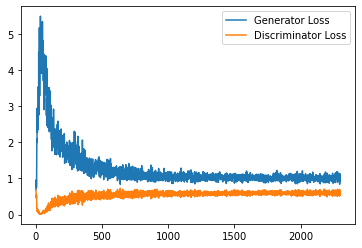

Step 46500: Generator loss: 1.005305894970894, discriminator loss: 0.5921511180996895


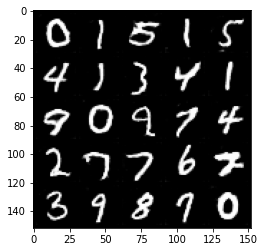

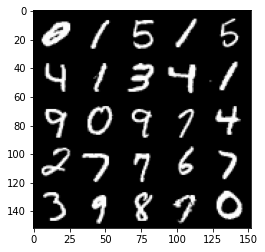

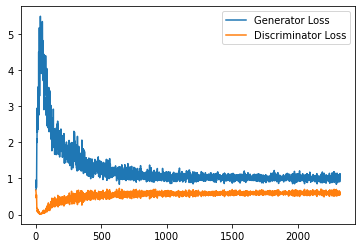

Step 47000: Generator loss: 1.0142919994592667, discriminator loss: 0.5852444786429405


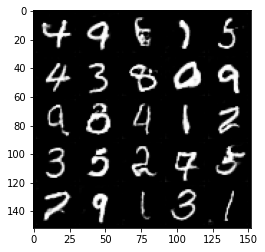

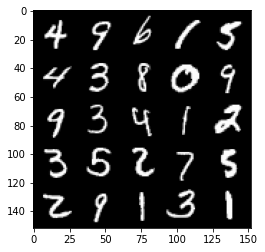

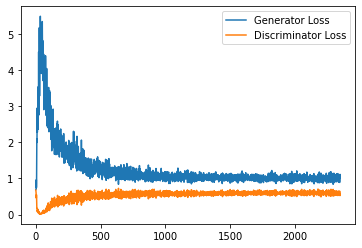

Step 47500: Generator loss: 1.0147935425043106, discriminator loss: 0.5878991191983223


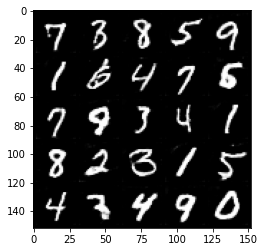

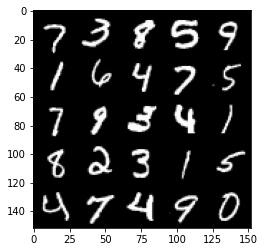

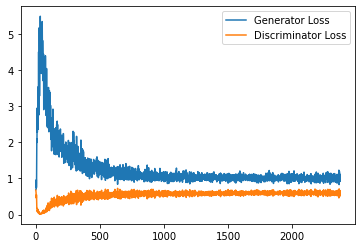

Step 48000: Generator loss: 1.0242561802864074, discriminator loss: 0.5819495848417282


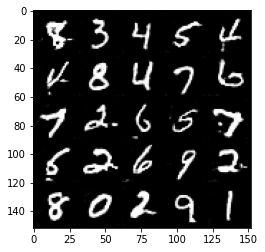

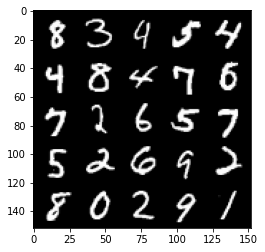

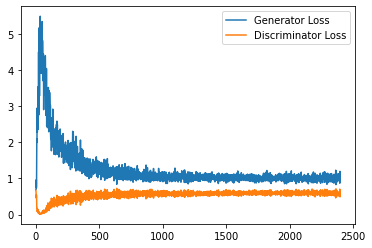

Step 48500: Generator loss: 1.0006744216680528, discriminator loss: 0.5921105010509491


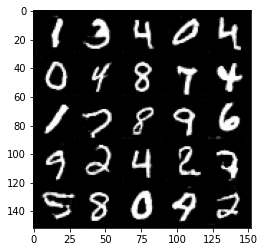

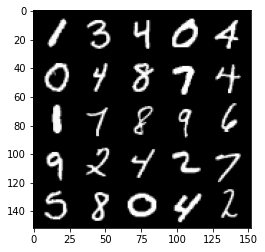

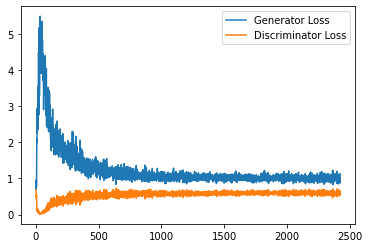

Step 49000: Generator loss: 1.0359309362173081, discriminator loss: 0.5825279387235641


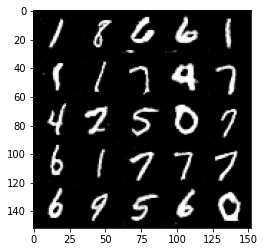

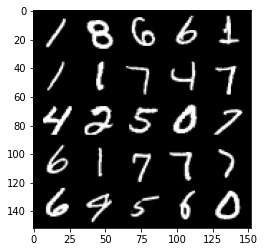

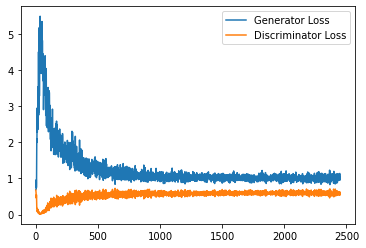

Step 49500: Generator loss: 1.0352044751644134, discriminator loss: 0.5779715859293938


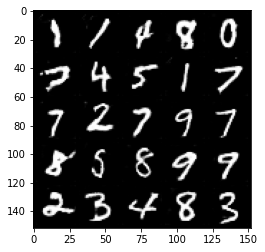

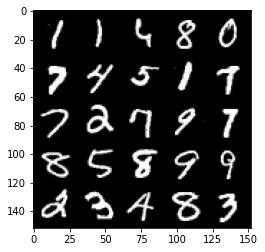

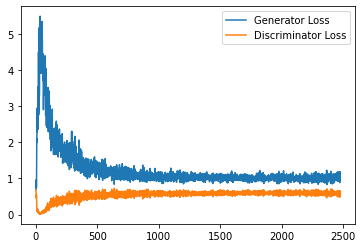

Step 50000: Generator loss: 1.0099778634309768, discriminator loss: 0.5871807529330254


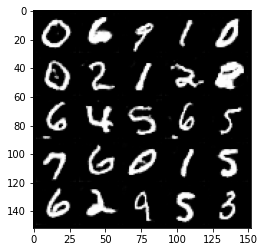

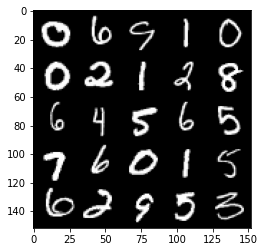

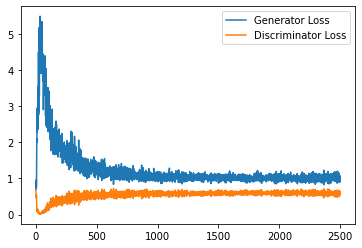

Step 50500: Generator loss: 1.0380874371528626, discriminator loss: 0.5861303532719612


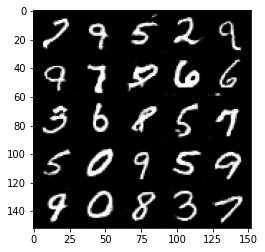

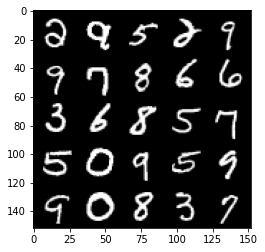

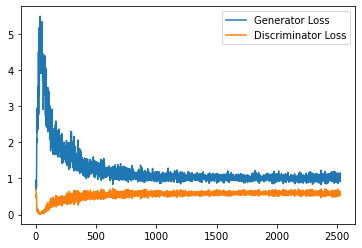

Step 51000: Generator loss: 1.0195172328948974, discriminator loss: 0.5870016781687737


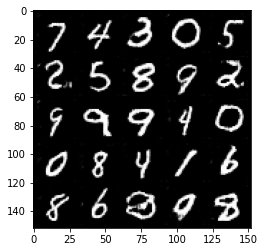

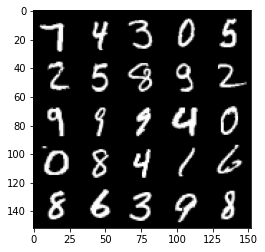

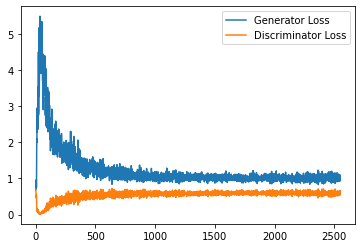

Step 51500: Generator loss: 1.036140179514885, discriminator loss: 0.5774036269187928


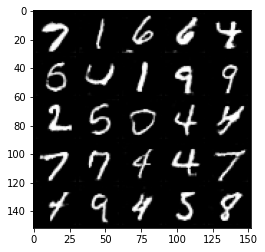

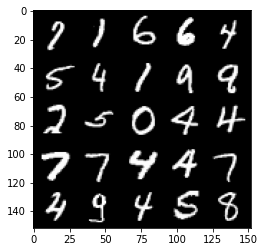

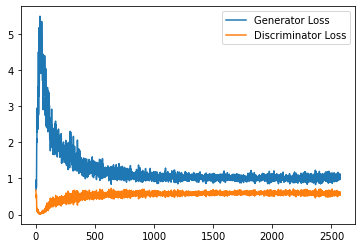

Step 52000: Generator loss: 1.0240690636634826, discriminator loss: 0.5827348248362542


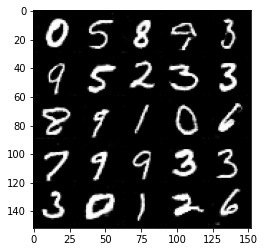

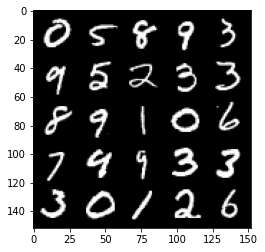

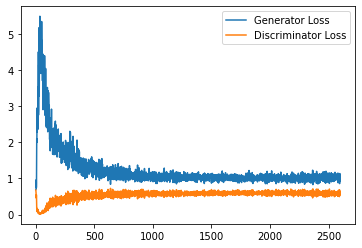

Step 52500: Generator loss: 1.044345876455307, discriminator loss: 0.5821359934806823


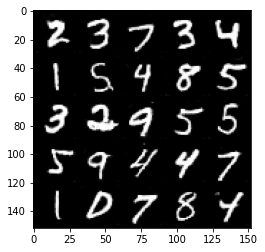

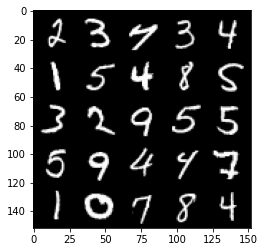

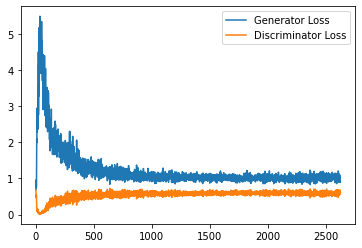

Step 53000: Generator loss: 1.0494349801540375, discriminator loss: 0.5773582247495651


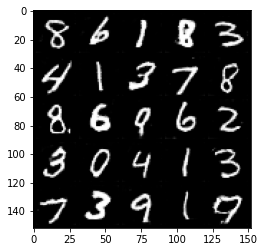

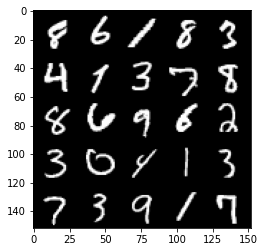

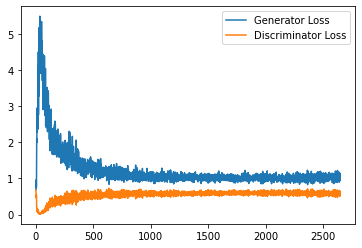

Step 53500: Generator loss: 1.0315847795009614, discriminator loss: 0.5794392412900925


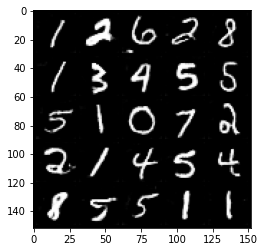

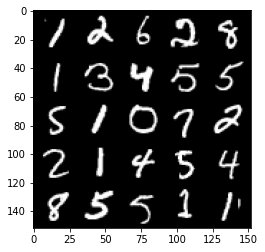

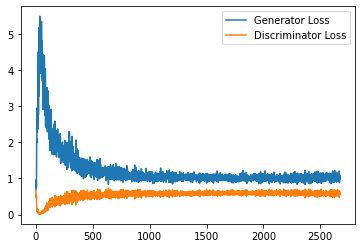

Step 54000: Generator loss: 1.028978845357895, discriminator loss: 0.5818033534884453


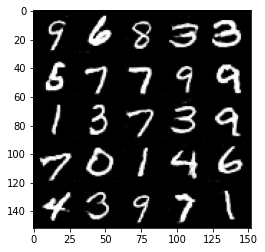

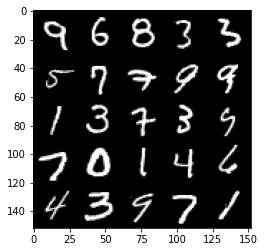

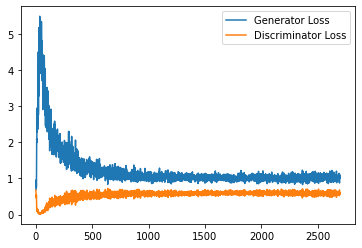

Step 54500: Generator loss: 1.0335646898746491, discriminator loss: 0.5781889612078667


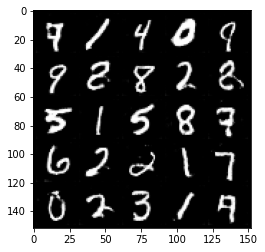

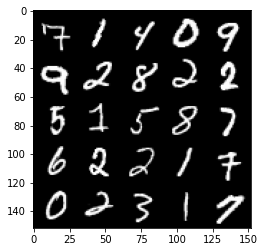

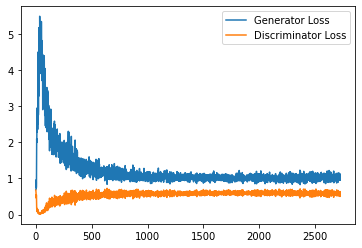

Step 55000: Generator loss: 1.029859023332596, discriminator loss: 0.5801440486907959


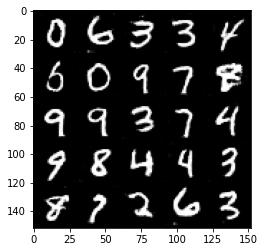

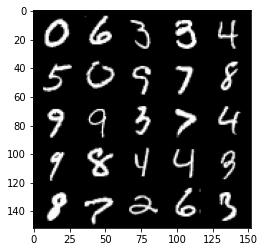

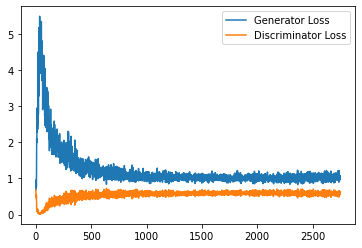

Step 55500: Generator loss: 1.0296312313079834, discriminator loss: 0.5769849832653999


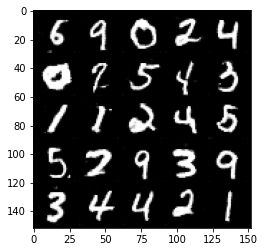

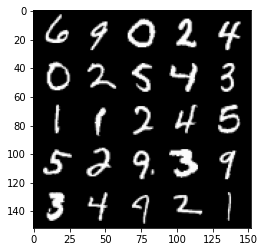

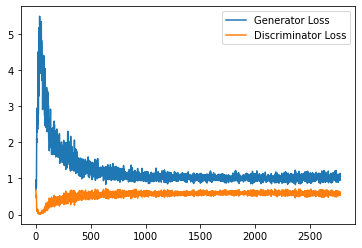

Step 56000: Generator loss: 1.0474490903615952, discriminator loss: 0.5793987098932266


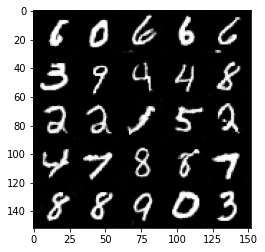

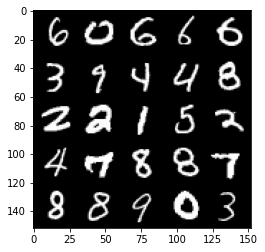

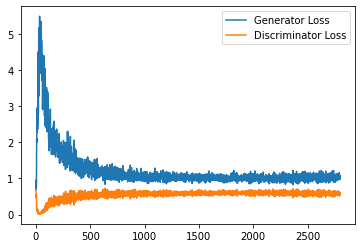

Step 56500: Generator loss: 1.042116133928299, discriminator loss: 0.5754073039889336


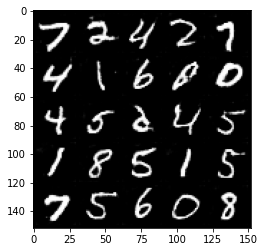

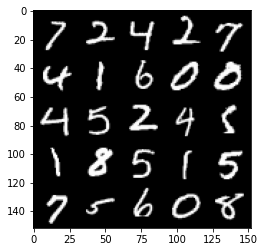

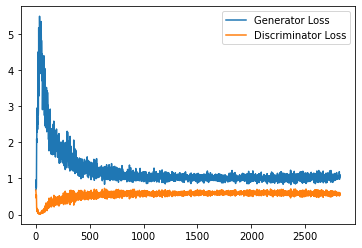

Step 57000: Generator loss: 1.0507416907548905, discriminator loss: 0.5739347831010818


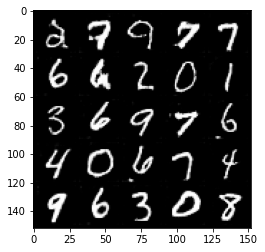

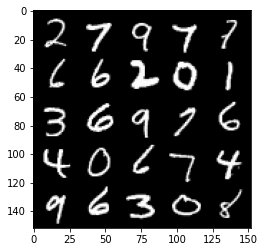

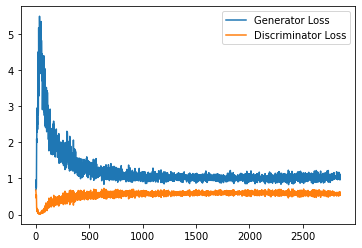

Step 57500: Generator loss: 1.0471358069181442, discriminator loss: 0.5739624887108803


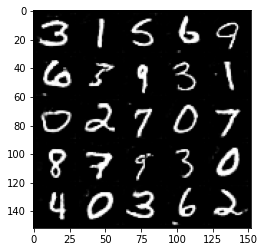

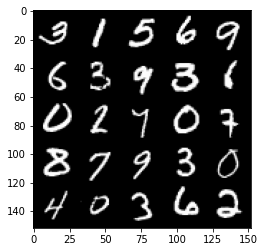

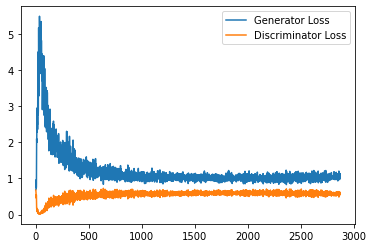

Step 58000: Generator loss: 1.0386830345392226, discriminator loss: 0.5745973224639893


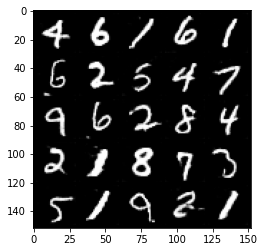

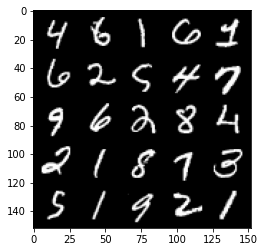

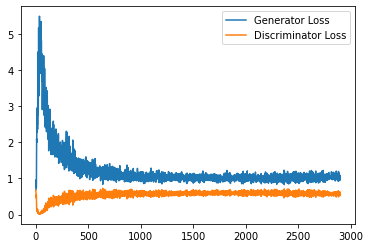

Step 58500: Generator loss: 1.034361003279686, discriminator loss: 0.5761621417999268


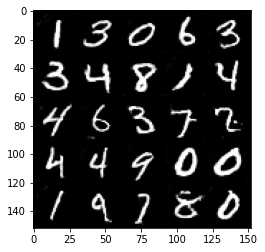

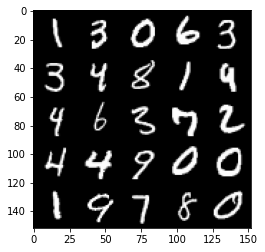

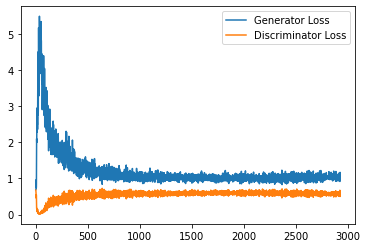

Step 59000: Generator loss: 1.052387937426567, discriminator loss: 0.5729670498371124


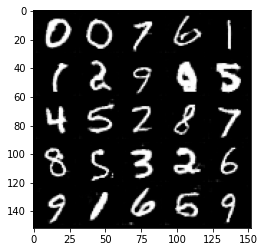

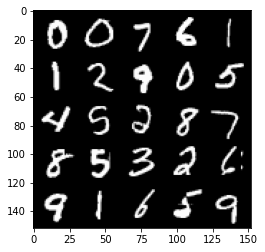

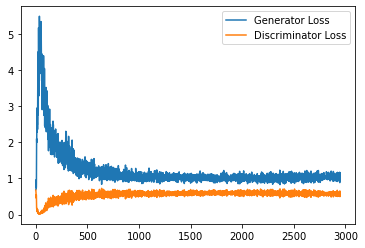

Step 59500: Generator loss: 1.0599548616409302, discriminator loss: 0.5772239181995392


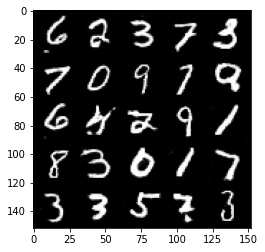

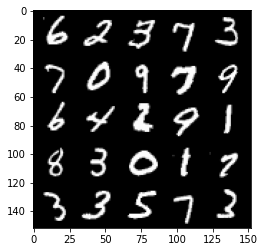

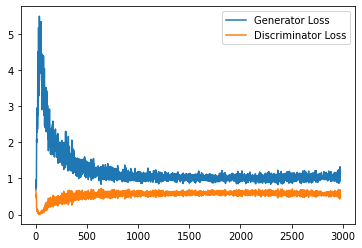

Step 60000: Generator loss: 1.0531615316867828, discriminator loss: 0.5698085415959359


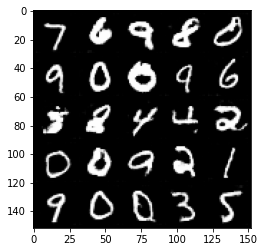

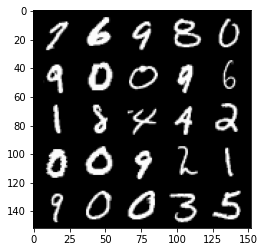

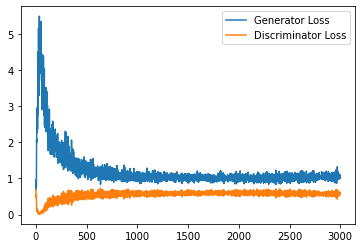

Step 60500: Generator loss: 1.0504897621870042, discriminator loss: 0.5744169097542763


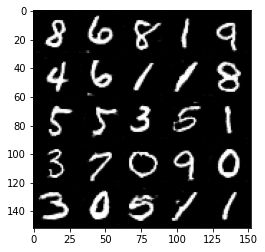

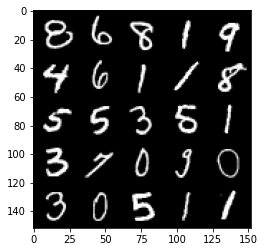

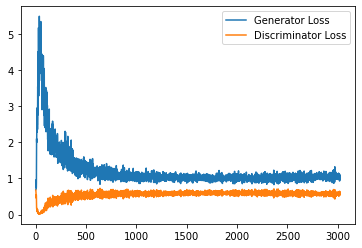

Step 61000: Generator loss: 1.0622714799642563, discriminator loss: 0.5730134653449058


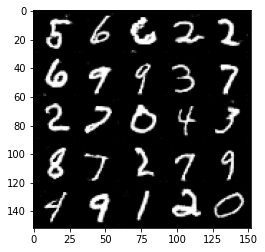

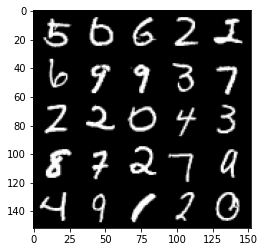

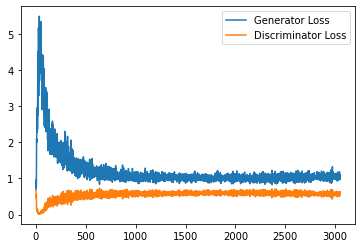

Step 61500: Generator loss: 1.0676766258478165, discriminator loss: 0.5726215670108795


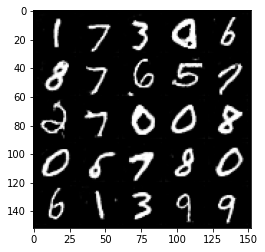

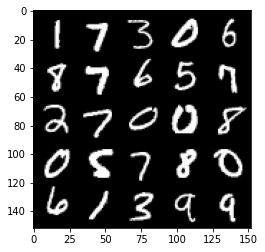

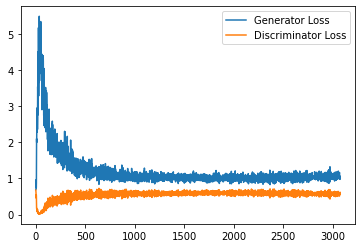

Step 62000: Generator loss: 1.034465871691704, discriminator loss: 0.5737145212292671


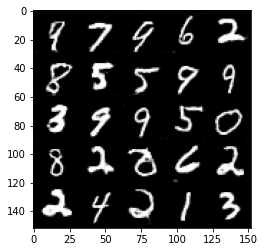

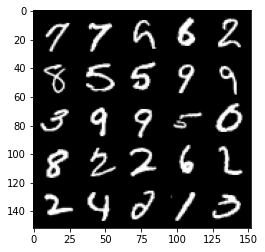

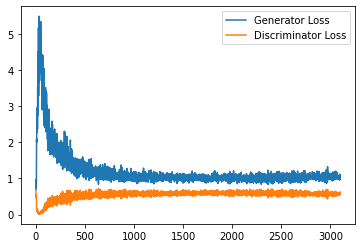

Step 62500: Generator loss: 1.0555032489299774, discriminator loss: 0.5724310351014137


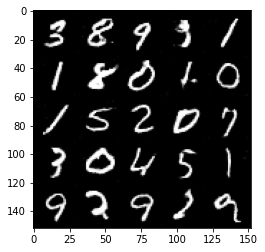

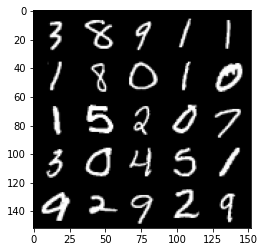

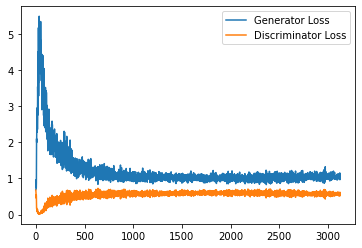

Step 63000: Generator loss: 1.063178078532219, discriminator loss: 0.5765275251269341


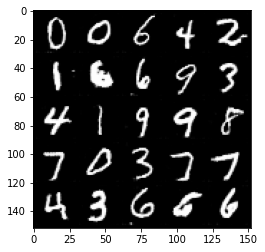

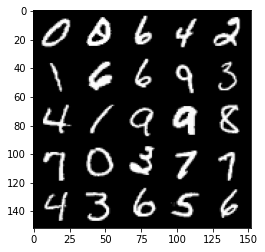

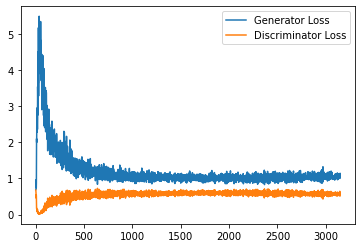

Step 63500: Generator loss: 1.0471787697076798, discriminator loss: 0.5755799262523651


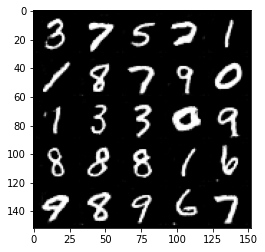

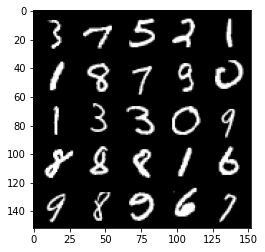

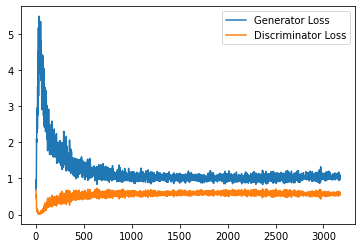

Step 64000: Generator loss: 1.0612945858240128, discriminator loss: 0.5716152469515801


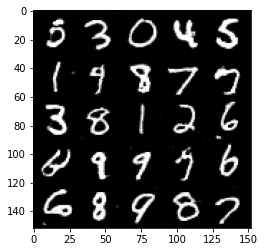

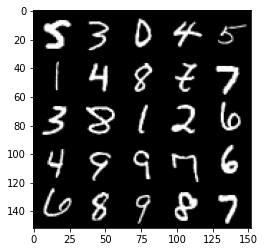

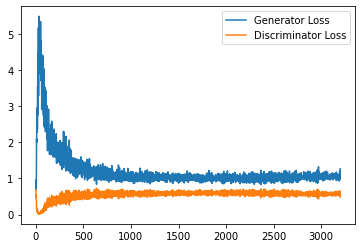

Step 64500: Generator loss: 1.0477465884685517, discriminator loss: 0.5784036793708801


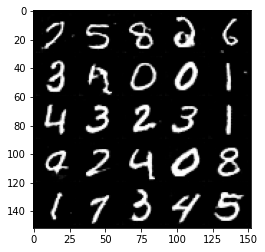

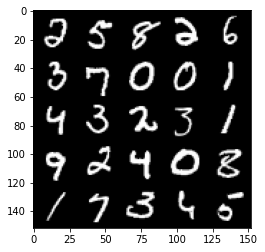

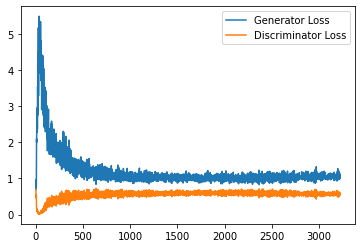

Step 65000: Generator loss: 1.038906856894493, discriminator loss: 0.5785397366285324


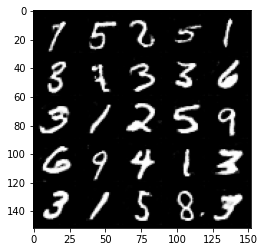

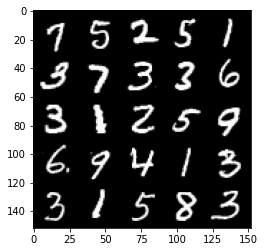

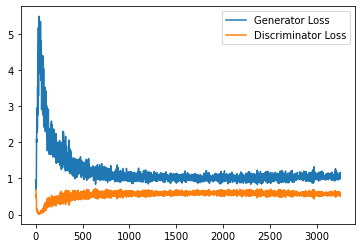

Step 65500: Generator loss: 1.0264619858264923, discriminator loss: 0.5793189743161201


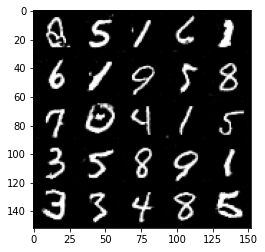

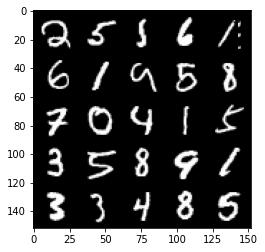

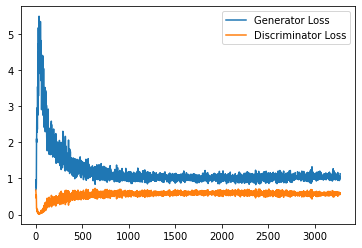

Step 66000: Generator loss: 1.042022466659546, discriminator loss: 0.5779556208252907


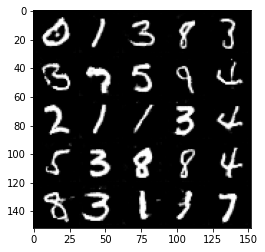

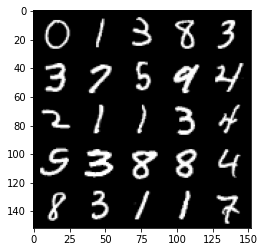

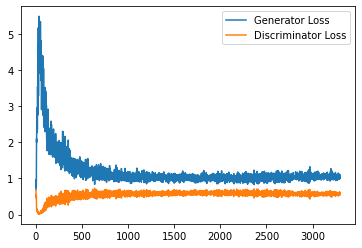

Step 66500: Generator loss: 1.050501471400261, discriminator loss: 0.5782585295438767


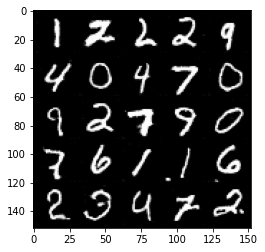

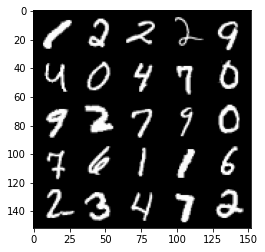

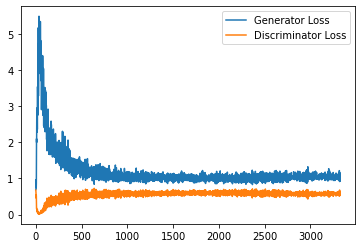

Step 67000: Generator loss: 1.0469539642333985, discriminator loss: 0.5779102636575699


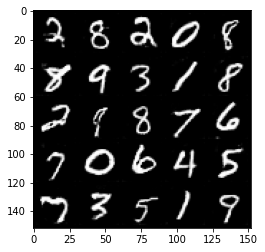

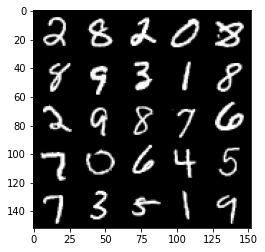

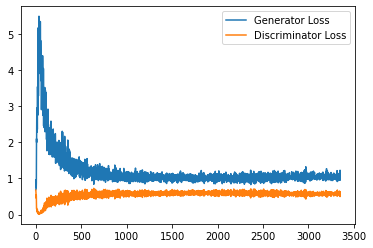

Step 67500: Generator loss: 1.0480392073392868, discriminator loss: 0.5812186933159829


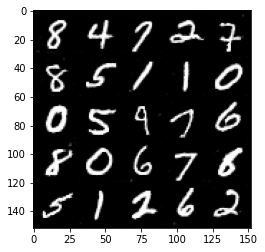

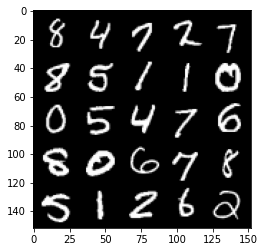

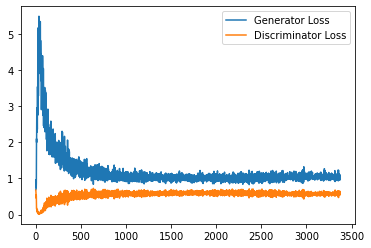

Step 68000: Generator loss: 1.0596975895166396, discriminator loss: 0.5799304765462875


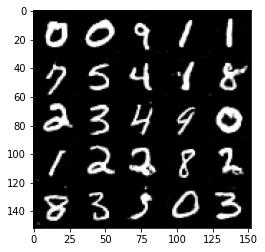

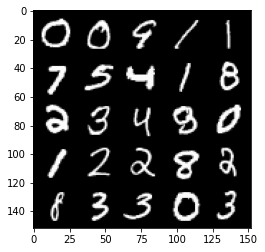

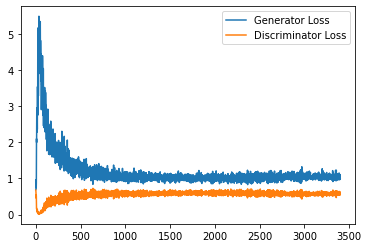

Step 68500: Generator loss: 1.054881759762764, discriminator loss: 0.5764732195138931


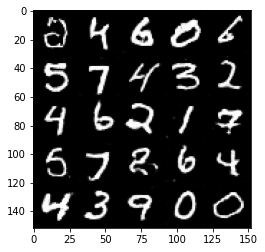

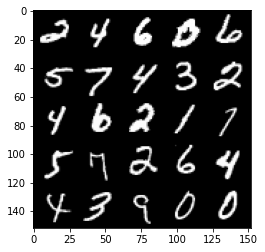

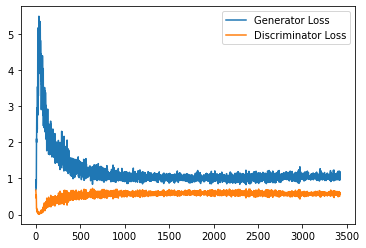

Step 69000: Generator loss: 1.0491609666347503, discriminator loss: 0.5792412496209145


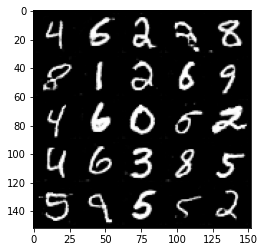

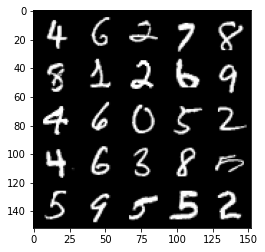

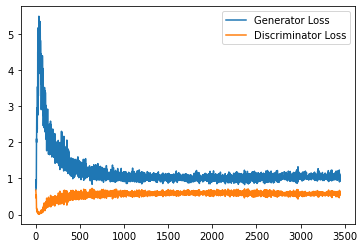

Step 69500: Generator loss: 1.0546418714523316, discriminator loss: 0.5772655020952224


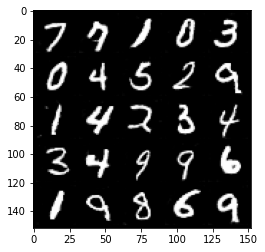

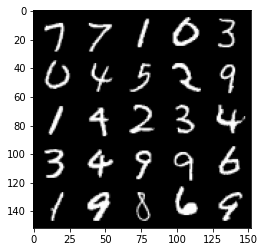

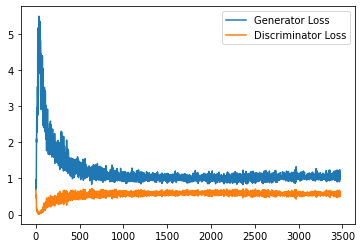

Step 70000: Generator loss: 1.0511507281064987, discriminator loss: 0.5789487589001655


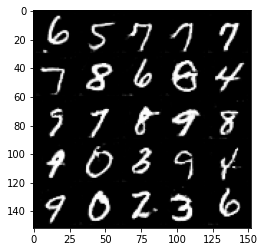

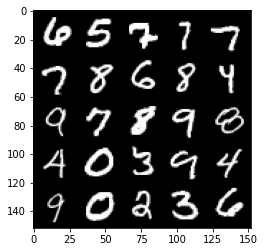

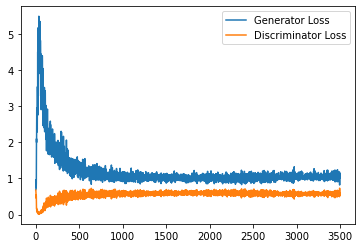

Step 70500: Generator loss: 1.0507566903829575, discriminator loss: 0.578726112484932


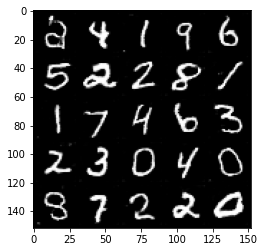

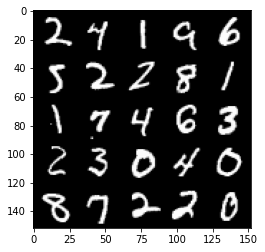

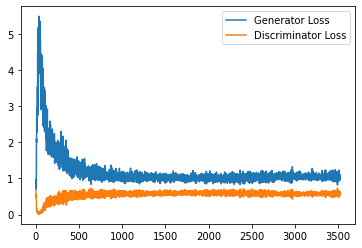

Step 71000: Generator loss: 1.0495740584135056, discriminator loss: 0.5854973737597465


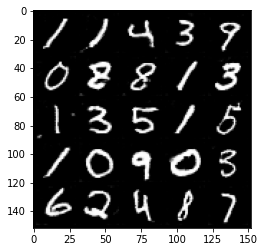

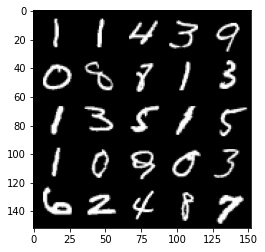

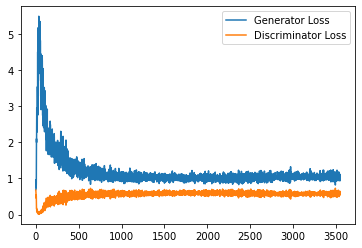

Step 71500: Generator loss: 1.0544341969490052, discriminator loss: 0.5750269986391068


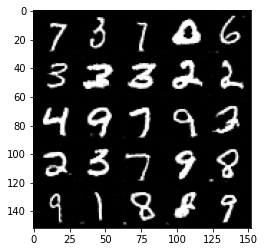

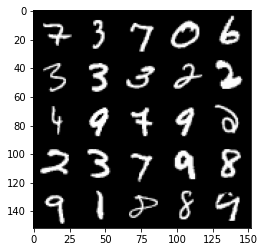

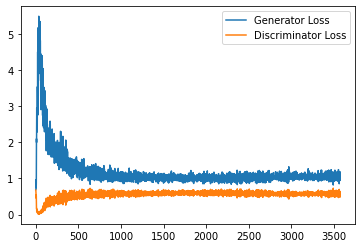

Step 72000: Generator loss: 1.0300218648910522, discriminator loss: 0.5861935503482819


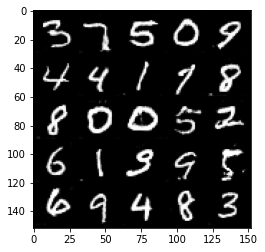

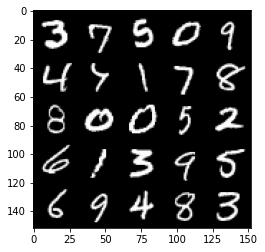

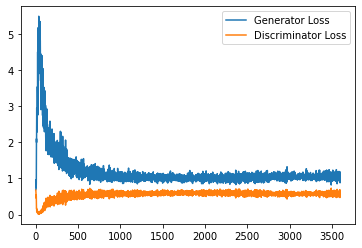

Step 72500: Generator loss: 1.0587966470718384, discriminator loss: 0.5801373072862626


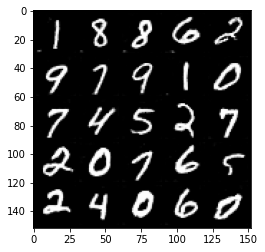

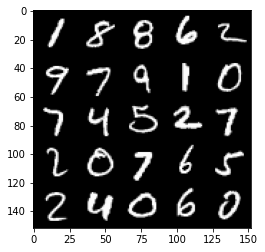

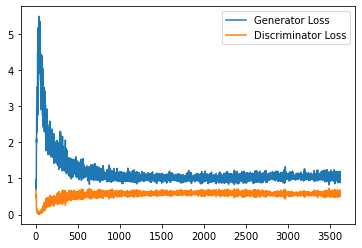

Step 73000: Generator loss: 1.0507588955163956, discriminator loss: 0.5876095004677773


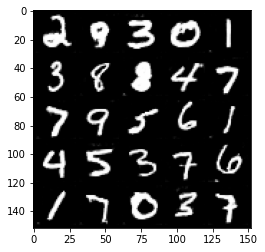

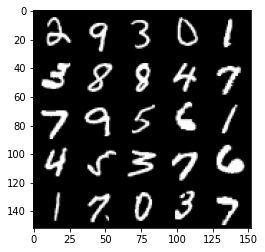

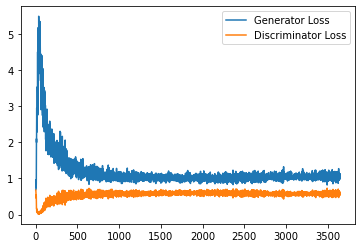

Step 73500: Generator loss: 1.0293369084596633, discriminator loss: 0.5793399703502655


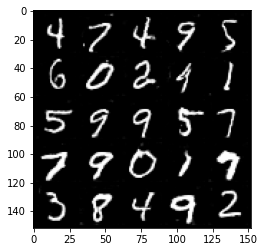

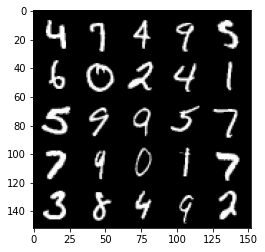

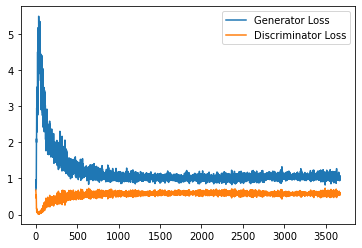

Step 74000: Generator loss: 1.0377826046943666, discriminator loss: 0.5835646767020225


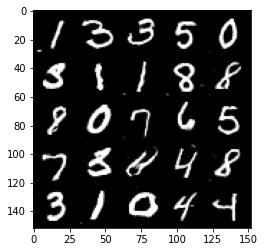

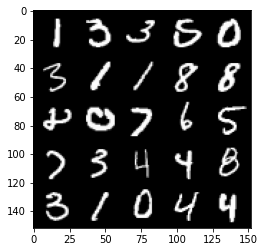

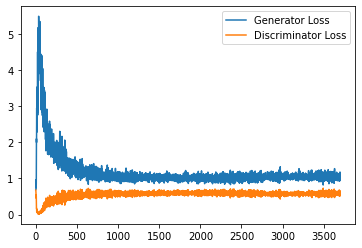

Step 74500: Generator loss: 1.0451782689094544, discriminator loss: 0.587027904510498


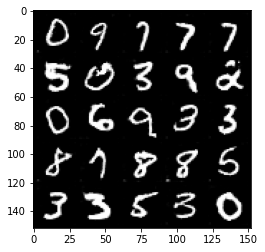

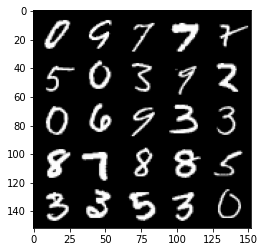

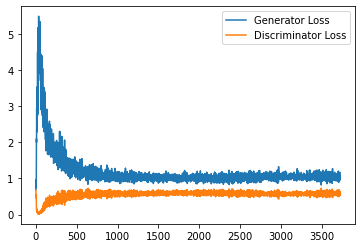

Step 75000: Generator loss: 1.0410704689025878, discriminator loss: 0.589236315369606


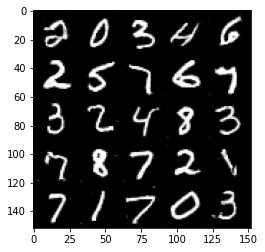

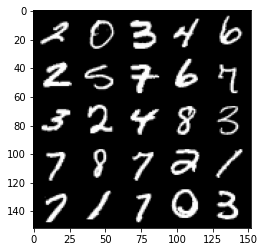

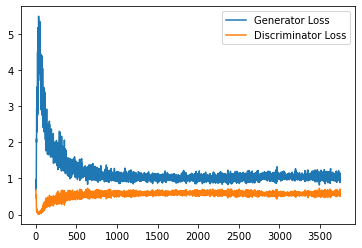

Step 75500: Generator loss: 1.0616605808734894, discriminator loss: 0.5788789588809014


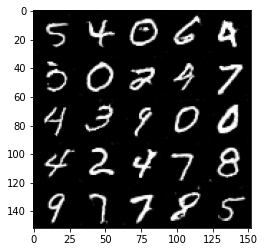

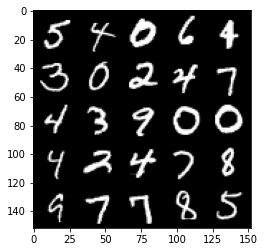

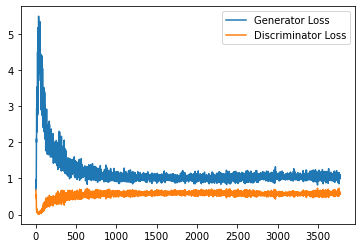

Step 76000: Generator loss: 1.0444911646842956, discriminator loss: 0.5818093840479851


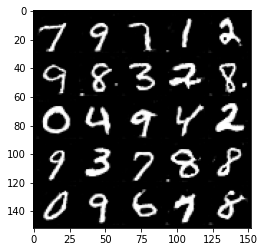

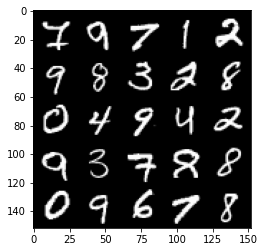

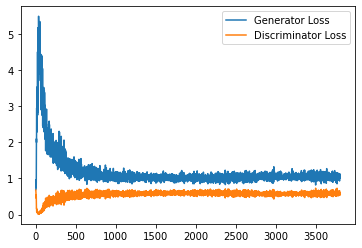

Step 76500: Generator loss: 1.0472577756643295, discriminator loss: 0.5843407762646675


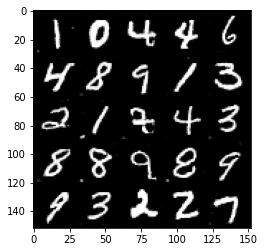

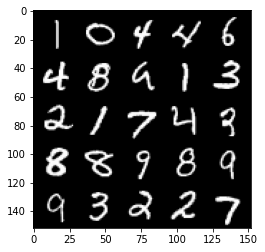

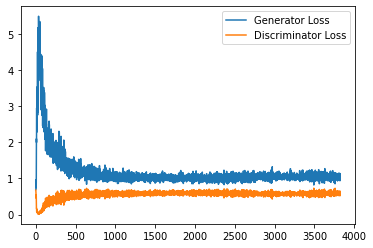

Step 77000: Generator loss: 1.041938530087471, discriminator loss: 0.5845667548179626


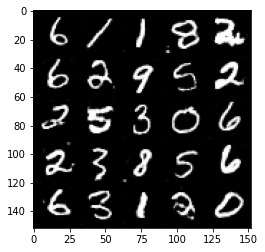

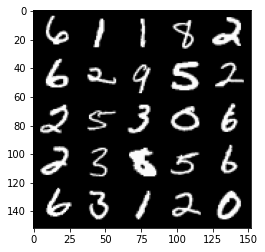

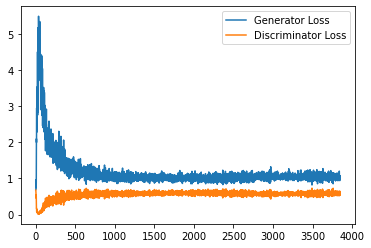

Step 77500: Generator loss: 1.0201994200944902, discriminator loss: 0.5896000955104828


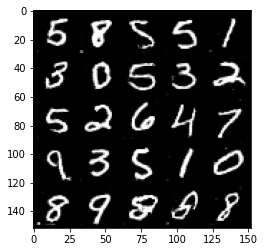

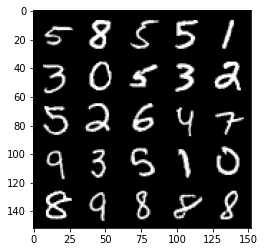

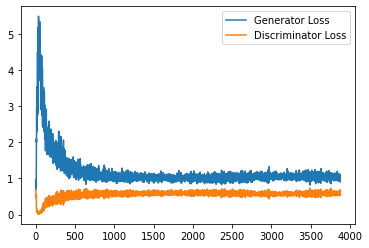

Step 78000: Generator loss: 1.0531341537237167, discriminator loss: 0.5859031361937523


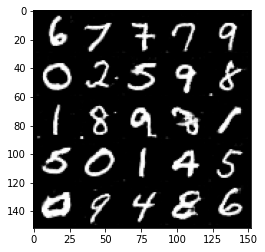

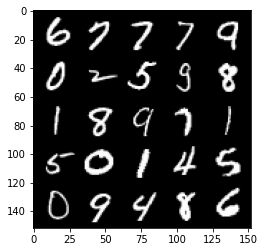

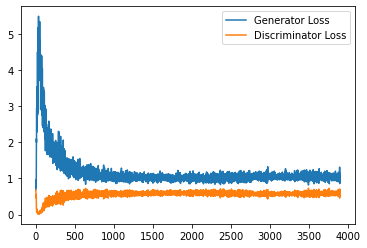

Step 78500: Generator loss: 1.0507203756570815, discriminator loss: 0.5840748934745789


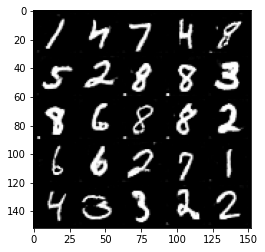

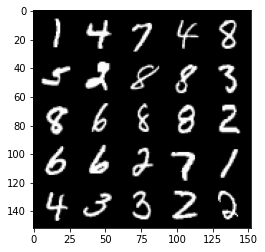

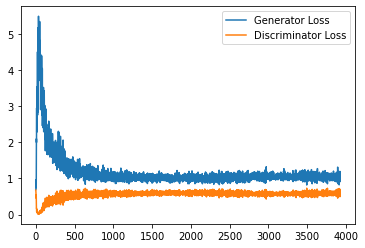

Step 79000: Generator loss: 1.0412839744091034, discriminator loss: 0.5925855437517166


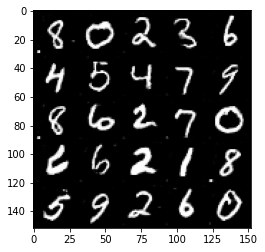

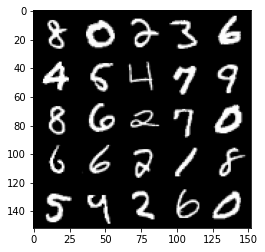

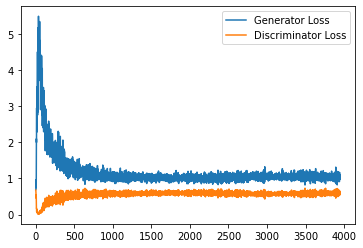

Step 79500: Generator loss: 1.0292142803668975, discriminator loss: 0.5934473096728324


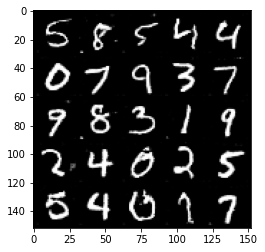

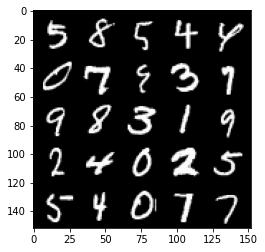

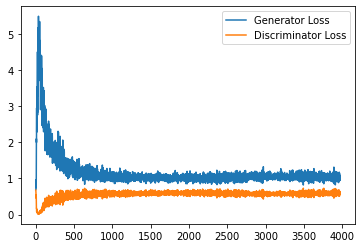

Step 80000: Generator loss: 1.0372301409244538, discriminator loss: 0.5921576358079911


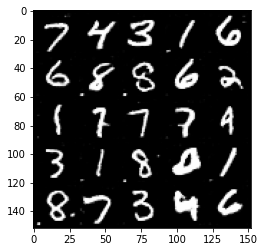

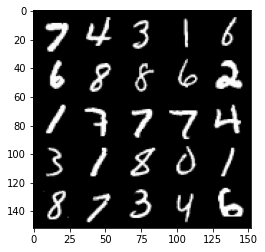

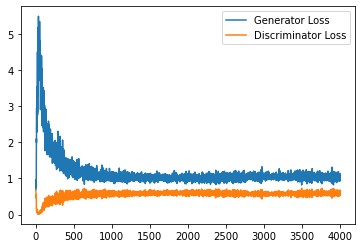

Step 80500: Generator loss: 1.0338464630842208, discriminator loss: 0.5900062839984894


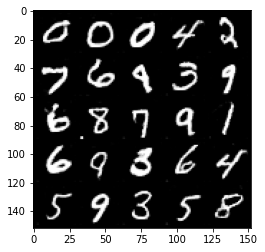

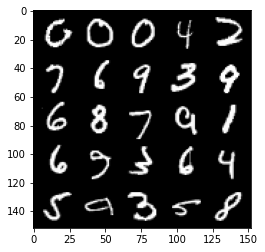

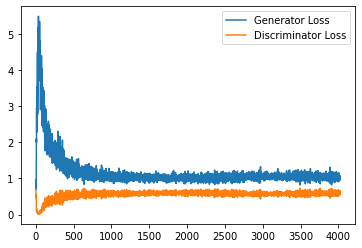

Step 81000: Generator loss: 1.027538334965706, discriminator loss: 0.5863216992020607


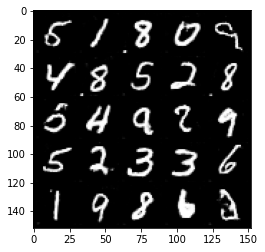

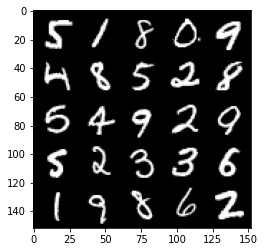

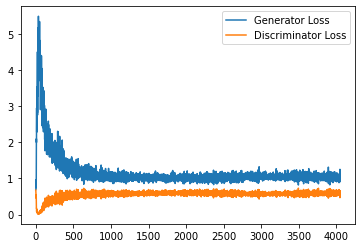

Step 81500: Generator loss: 1.03847809445858, discriminator loss: 0.5848885151147842


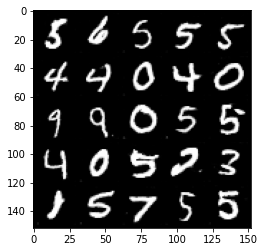

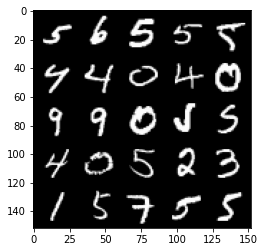

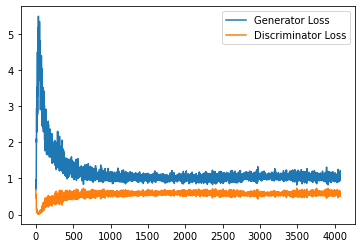

Step 82000: Generator loss: 1.0303978990316391, discriminator loss: 0.5898712362647056


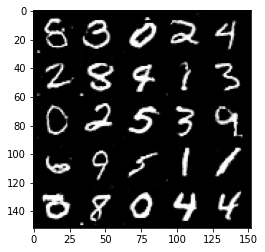

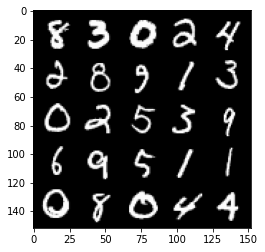

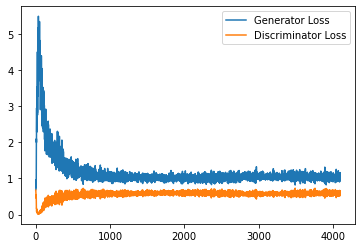

Step 82500: Generator loss: 1.027256886959076, discriminator loss: 0.595304983317852


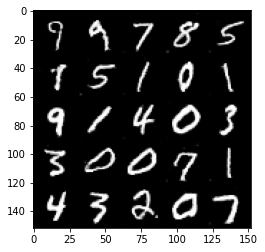

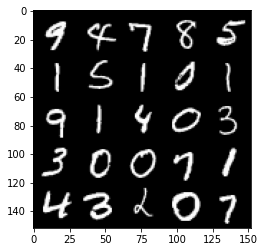

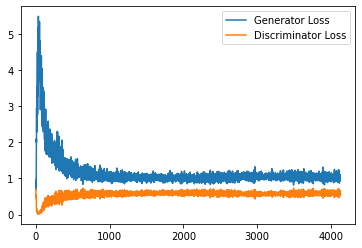

Step 83000: Generator loss: 1.0398905130624772, discriminator loss: 0.5893588880896569


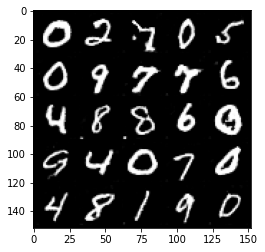

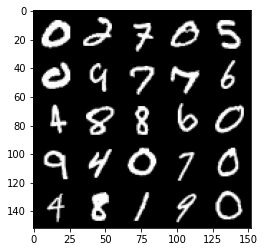

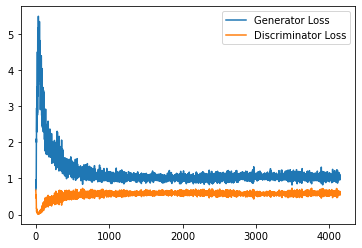

Step 83500: Generator loss: 1.03204480946064, discriminator loss: 0.590802916586399


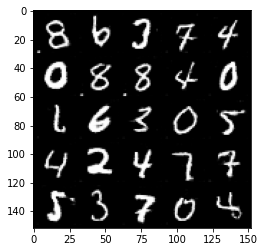

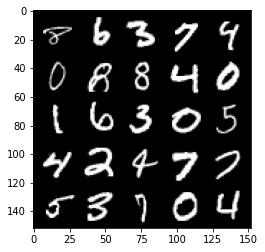

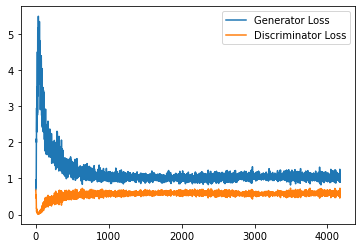

Step 84000: Generator loss: 1.0390932581424712, discriminator loss: 0.5887364547252655


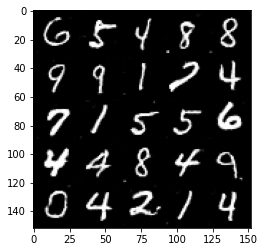

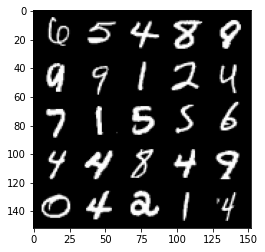

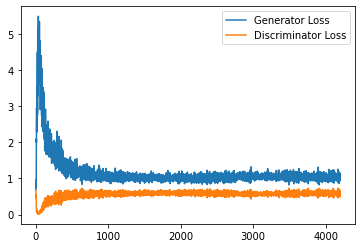

Step 84500: Generator loss: 1.0252662061452866, discriminator loss: 0.5948620486855507


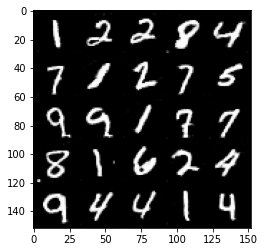

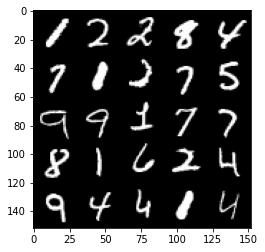

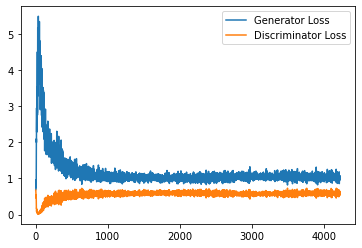

Step 85000: Generator loss: 1.0397573130130768, discriminator loss: 0.5918184459805489


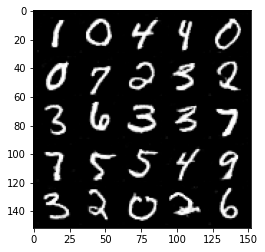

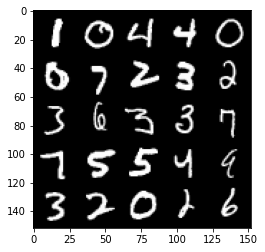

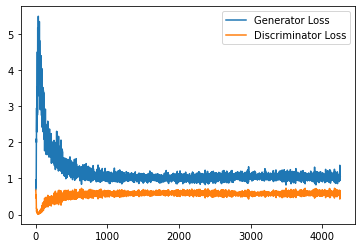

Step 85500: Generator loss: 1.0401579612493514, discriminator loss: 0.5865402155518532


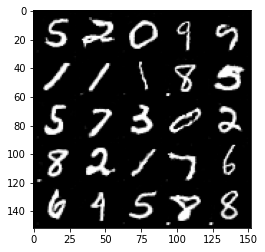

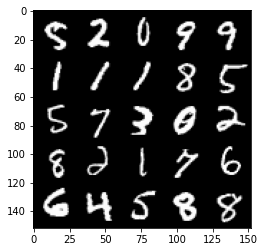

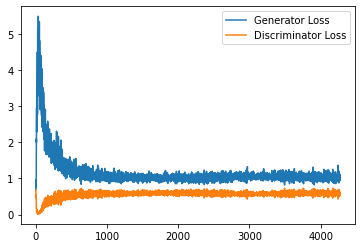

Step 86000: Generator loss: 1.0395091899633409, discriminator loss: 0.5908638564348221


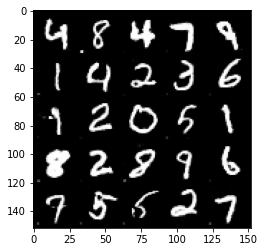

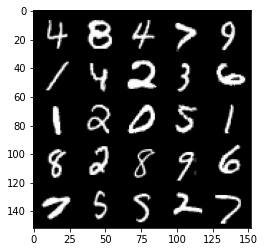

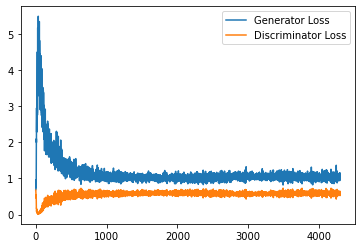

Step 86500: Generator loss: 1.0317660222053529, discriminator loss: 0.5898312305212021


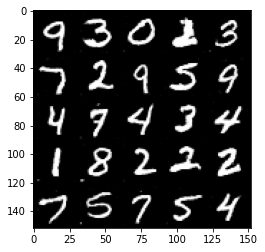

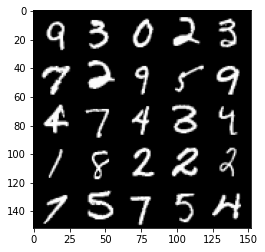

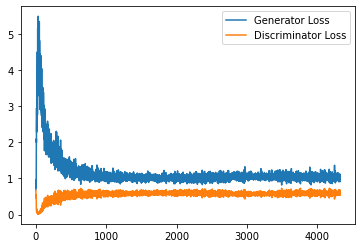

Step 87000: Generator loss: 1.0419147255420684, discriminator loss: 0.5912210761904716


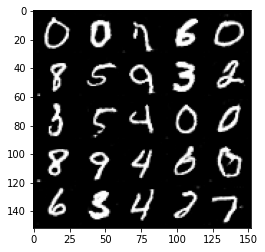

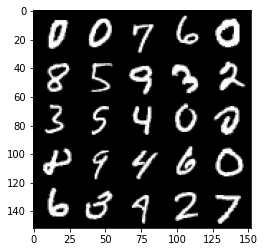

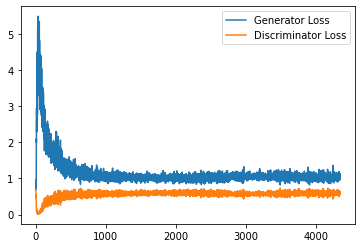

Step 87500: Generator loss: 1.038618236899376, discriminator loss: 0.5899015736579895


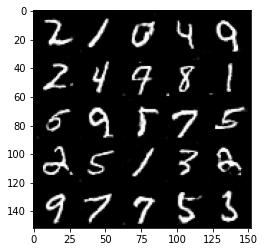

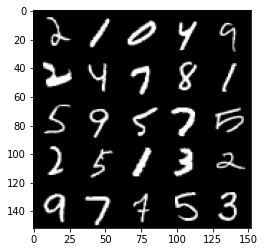

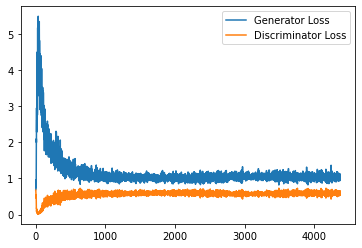

Step 88000: Generator loss: 1.026501796245575, discriminator loss: 0.5967695105671883


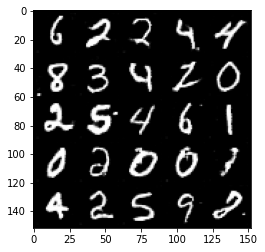

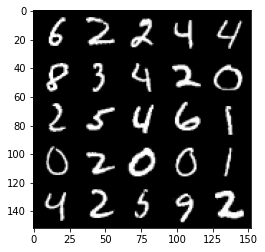

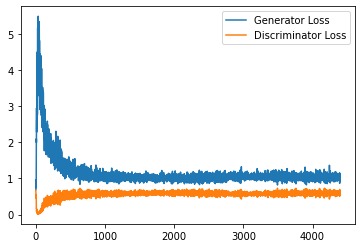

Step 88500: Generator loss: 1.033152331352234, discriminator loss: 0.5903229277133941


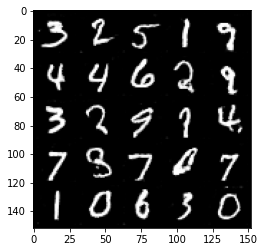

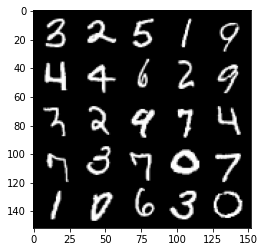

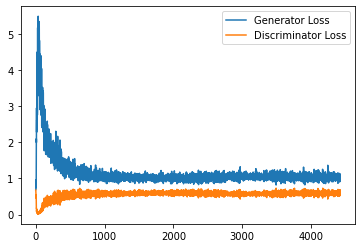

Step 89000: Generator loss: 1.0302414269447326, discriminator loss: 0.5909106417894363


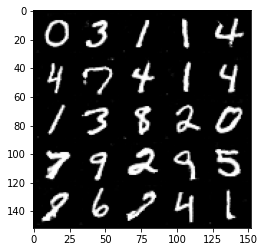

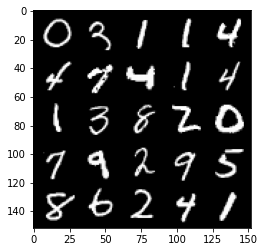

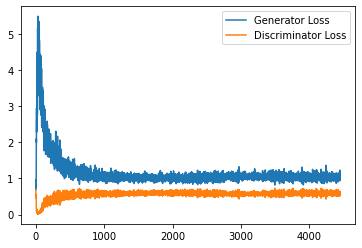

Step 89500: Generator loss: 1.0268237228393555, discriminator loss: 0.592073015332222


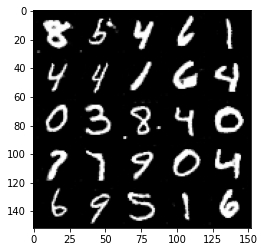

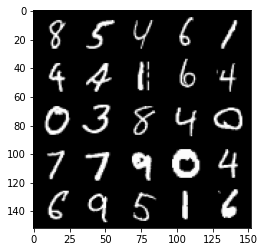

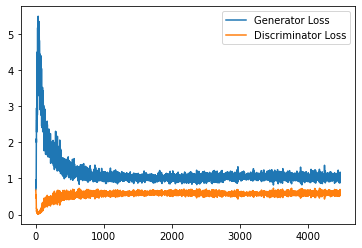

Step 90000: Generator loss: 1.0380829017162323, discriminator loss: 0.5933871886134148


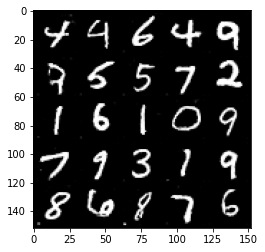

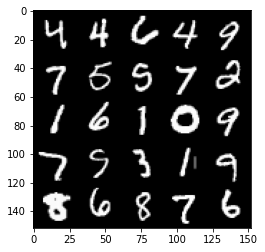

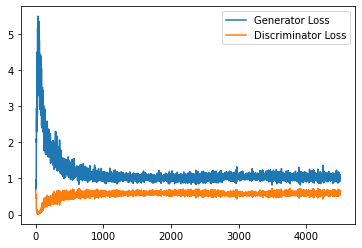

Step 90500: Generator loss: 1.025449580669403, discriminator loss: 0.5908386090993881


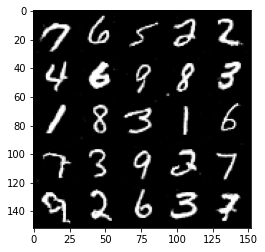

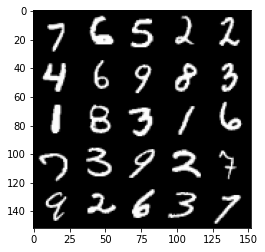

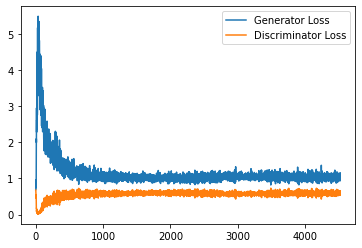

Step 91000: Generator loss: 1.0352608751058578, discriminator loss: 0.5966453865766526


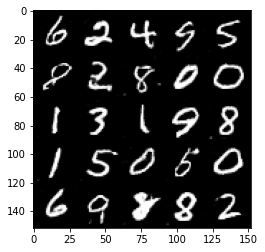

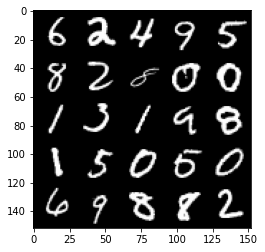

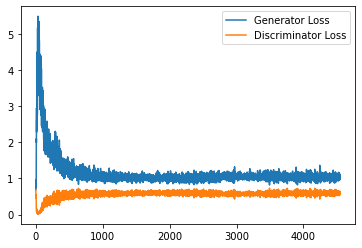

Step 91500: Generator loss: 1.0188472648859024, discriminator loss: 0.5915311900377274


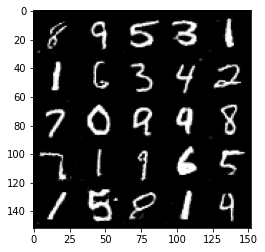

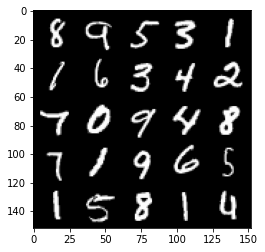

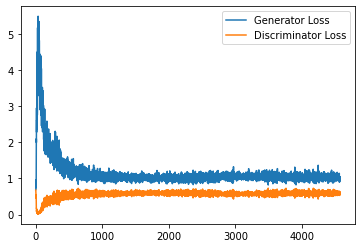

Step 92000: Generator loss: 1.0219141297340393, discriminator loss: 0.5976069753170014


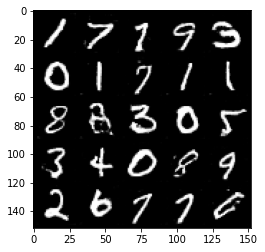

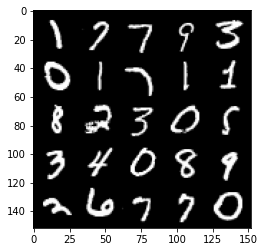

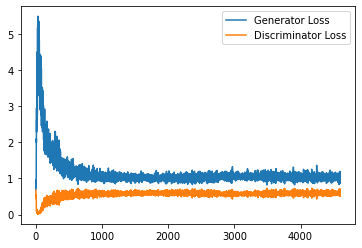

Step 92500: Generator loss: 1.025374888420105, discriminator loss: 0.5998960670232772


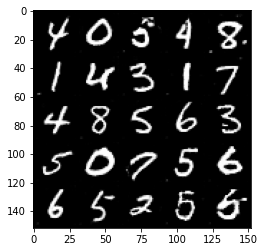

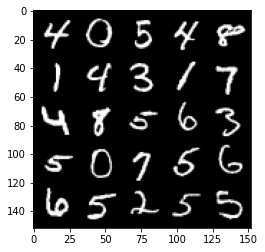

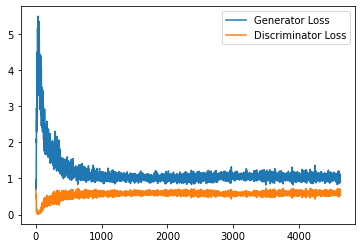

Step 93000: Generator loss: 1.036310033082962, discriminator loss: 0.5977541270256043


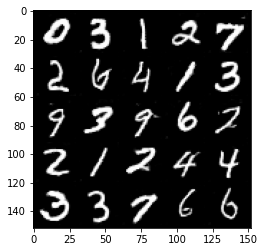

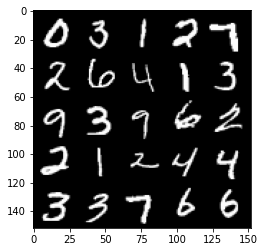

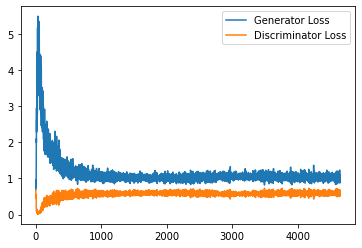

Step 93500: Generator loss: 1.0053912024497986, discriminator loss: 0.5996511698961258


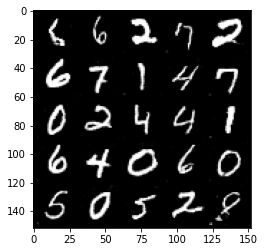

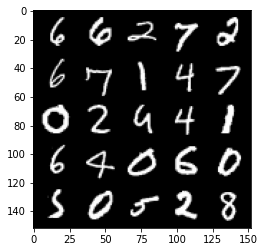

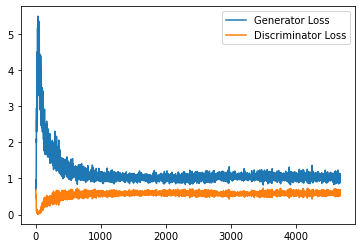

In [13]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED CELL
cur_step = 0
generator_losses = []
discriminator_losses = []

#UNIT TEST NOTE: Initializations needed for grading
noise_and_labels = False
fake = False

fake_image_and_labels = False
real_image_and_labels = False
disc_fake_pred = False
disc_real_pred = False

for epoch in range(n_epochs):
    # Dataloader returns the batches and the labels
    for real, labels in tqdm(dataloader):
        cur_batch_size = len(real)
        # Flatten the batch of real images from the dataset
        real = real.to(device)

        one_hot_labels = get_one_hot_labels(labels.to(device), n_classes)
        image_one_hot_labels = one_hot_labels[:, :, None, None]
        image_one_hot_labels = image_one_hot_labels.repeat(1, 1, mnist_shape[1], mnist_shape[2])

        ### Update discriminator ###
        # Zero out the discriminator gradients
        disc_opt.zero_grad()
        # Get noise corresponding to the current batch_size 
        fake_noise = get_noise(cur_batch_size, z_dim, device=device)
        
        # Now you can get the images from the generator
        # Steps: 1) Combine the noise vectors and the one-hot labels for the generator
        #        2) Generate the conditioned fake images
       
        #### START CODE HERE ####
        noise_and_labels = combine_vectors(fake_noise, one_hot_labels)
        fake = gen(noise_and_labels)
        #### END CODE HERE ####
        
        # Make sure that enough images were generated
        assert len(fake) == len(real)
        # Check that correct tensors were combined
        assert tuple(noise_and_labels.shape) == (cur_batch_size, fake_noise.shape[1] + one_hot_labels.shape[1])
        # It comes from the correct generator
        assert tuple(fake.shape) == (len(real), 1, 28, 28)

        # Now you can get the predictions from the discriminator
        # Steps: 1) Create the input for the discriminator
        #           a) Combine the fake images with image_one_hot_labels, 
        #              remember to detach the generator (.detach()) so you do not backpropagate through it
        #           b) Combine the real images with image_one_hot_labels
        #        2) Get the discriminator's prediction on the fakes as disc_fake_pred
        #        3) Get the discriminator's prediction on the reals as disc_real_pred
        
        #### START CODE HERE ####
        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        real_image_and_labels = combine_vectors(real, image_one_hot_labels)
        disc_fake_pred = disc(fake_image_and_labels.detach())
        disc_real_pred = disc(real_image_and_labels)
        #### END CODE HERE ####
        
        # Make sure shapes are correct 
        assert tuple(fake_image_and_labels.shape) == (len(real), fake.detach().shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        assert tuple(real_image_and_labels.shape) == (len(real), real.shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        # Make sure that enough predictions were made
        assert len(disc_real_pred) == len(real)
        # Make sure that the inputs are different
        assert torch.any(fake_image_and_labels != real_image_and_labels)
        # Shapes must match
        assert tuple(fake_image_and_labels.shape) == tuple(real_image_and_labels.shape)
        assert tuple(disc_fake_pred.shape) == tuple(disc_real_pred.shape)
        
        
        disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
        disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))
        disc_loss = (disc_fake_loss + disc_real_loss) / 2
        disc_loss.backward(retain_graph=True)
        disc_opt.step() 

        # Keep track of the average discriminator loss
        discriminator_losses += [disc_loss.item()]

        ### Update generator ###
        # Zero out the generator gradients
        gen_opt.zero_grad()

        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        # This will error if you didn't concatenate your labels to your image correctly
        disc_fake_pred = disc(fake_image_and_labels)
        gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))
        gen_loss.backward()
        gen_opt.step()

        # Keep track of the generator losses
        generator_losses += [gen_loss.item()]
        #

        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            disc_mean = sum(discriminator_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, discriminator loss: {disc_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            x_axis = sorted([i * step_bins for i in range(len(generator_losses) // step_bins)] * step_bins)
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(discriminator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Discriminator Loss"
            )
            plt.legend()
            plt.show()
        elif cur_step == 0:
            print("Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!")
        cur_step += 1

## Exploration
You can do a bit of exploration now!

In [14]:
# Before you explore, you should put the generator
# in eval mode, both in general and so that batch norm
# doesn't cause you issues and is using its eval statistics
gen = gen.eval()

#### Changing the Class Vector
You can generate some numbers with your new model! You can add interpolation as well to make it more interesting.

So starting from a image, you will produce intermediate images that look more and more like the ending image until you get to the final image. Your're basically morphing one image into another. You can choose what these two images will be using your conditional GAN.

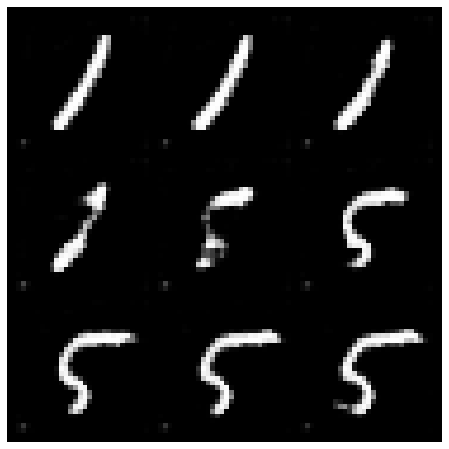

In [15]:
import math

### Change me! ###
n_interpolation = 9 # Choose the interpolation: how many intermediate images you want + 2 (for the start and end image)
interpolation_noise = get_noise(1, z_dim, device=device).repeat(n_interpolation, 1)

def interpolate_class(first_number, second_number):
    first_label = get_one_hot_labels(torch.Tensor([first_number]).long(), n_classes)
    second_label = get_one_hot_labels(torch.Tensor([second_number]).long(), n_classes)

    # Calculate the interpolation vector between the two labels
    percent_second_label = torch.linspace(0, 1, n_interpolation)[:, None]
    interpolation_labels = first_label * (1 - percent_second_label) + second_label * percent_second_label

    # Combine the noise and the labels
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_labels.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

### Change me! ###
start_plot_number = 1 # Choose the start digit
### Change me! ###
end_plot_number = 5 # Choose the end digit

plt.figure(figsize=(8, 8))
interpolate_class(start_plot_number, end_plot_number)
_ = plt.axis('off')

### Uncomment the following lines of code if you would like to visualize a set of pairwise class 
### interpolations for a collection of different numbers, all in a single grid of interpolations.
### You'll also see another visualization like this in the next code block!
# plot_numbers = [2, 3, 4, 5, 7]
# n_numbers = len(plot_numbers)
# plt.figure(figsize=(8, 8))
# for i, first_plot_number in enumerate(plot_numbers):
#     for j, second_plot_number in enumerate(plot_numbers):
#         plt.subplot(n_numbers, n_numbers, i * n_numbers + j + 1)
#         interpolate_class(first_plot_number, second_plot_number)
#         plt.axis('off')
# plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
# plt.show()
# plt.close()

#### Changing the Noise Vector
Now, what happens if you hold the class constant, but instead you change the noise vector? You can also interpolate the noise vector and generate an image at each step.

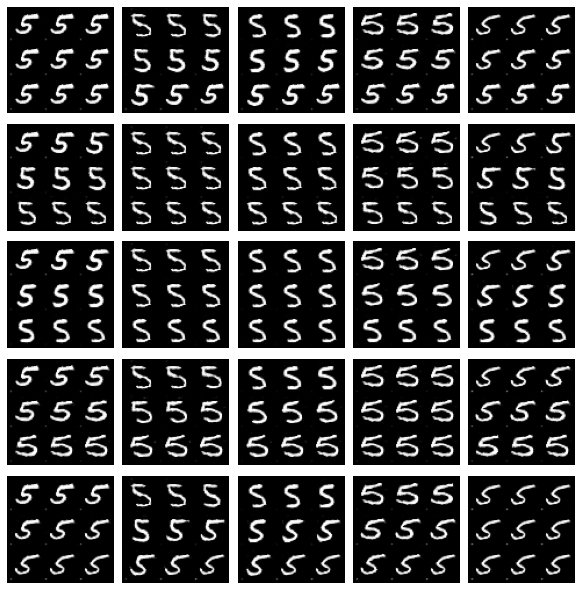

In [16]:
n_interpolation = 9 # How many intermediate images you want + 2 (for the start and end image)

# This time you're interpolating between the noise instead of the labels
interpolation_label = get_one_hot_labels(torch.Tensor([5]).long(), n_classes).repeat(n_interpolation, 1).float()

def interpolate_noise(first_noise, second_noise):
    # This time you're interpolating between the noise instead of the labels
    percent_first_noise = torch.linspace(0, 1, n_interpolation)[:, None].to(device)
    interpolation_noise = first_noise * percent_first_noise + second_noise * (1 - percent_first_noise)

    # Combine the noise and the labels again
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_label.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

# Generate noise vectors to interpolate between
### Change me! ###
n_noise = 5 # Choose the number of noise examples in the grid
plot_noises = [get_noise(1, z_dim, device=device) for i in range(n_noise)]
plt.figure(figsize=(8, 8))
for i, first_plot_noise in enumerate(plot_noises):
    for j, second_plot_noise in enumerate(plot_noises):
        plt.subplot(n_noise, n_noise, i * n_noise + j + 1)
        interpolate_noise(first_plot_noise, second_plot_noise)
        plt.axis('off')
plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
plt.show()
plt.close()